# SV and DU test results of the coronal brain section (CBS1 and CBS2)

In [1]:
import torch
import numpy as np
from scipy.io import mmread
from scipy.stats import spearmanr, chisquare, chi2_contingency
import pandas as pd
import itertools
import matplotlib.pyplot as plt
from plotnine import *

import scanpy as sc

from isosde.utils import get_cov_sp, counts_to_ratios, load_visium_sp_meta

In [2]:
data_dir = "/Users/jysumac/Projects/SPLISOSM_paper/data/sit_nar_23/"
res_dir = "/Users/jysumac/Projects/SPLISOSM_paper/results/sit_nar_23/"
date = '1107'

## Spatial variablility (SV) tests

### Load SV test results

In [3]:
df_sv_cbs1 = pd.read_csv(f"{res_dir}/sv_results/cbs1_sv_combined_{date}.csv", index_col=0)
df_sv_cbs2 = pd.read_csv(f"{res_dir}/sv_results/cbs2_sv_combined_{date}.csv", index_col=0)

# define significant events
for _df in [df_sv_cbs1, df_sv_cbs2]:
    _df['is_ont_svs'] = _df['padj_hsic-ir'] < 0.05
    _df['is_ont_sve'] = _df['padj_hsic-gc'] < 0.05
    _df['is_ont_expressed'] = _df['count_avg'] > 0.5

# merge two cbs samples into one df
df_sv_cbs = pd.merge(
    df_sv_cbs1, df_sv_cbs2, 
    how='inner', left_index=True, right_index=True, 
    suffixes=['_1', '_2']
)

# keep significant genes in both samples
df_sv_cbs['is_ont_svs'] = df_sv_cbs['is_ont_svs_1'] & df_sv_cbs['is_ont_svs_2']
df_sv_cbs['is_ont_sve'] = df_sv_cbs['is_ont_sve_1'] & df_sv_cbs['is_ont_sve_2']
df_sv_cbs['is_ont_expressed'] = df_sv_cbs['is_ont_expressed_1'] & df_sv_cbs['is_ont_expressed_2']

df_sv_cbs.groupby(['is_ont_expressed', 'is_ont_svs', 'is_ont_sve']).size()

is_ont_expressed  is_ont_svs  is_ont_sve
False             False       False          165
                              True          1333
                  True        False            1
                              True            57
True              False       True           560
                  True        True            92
dtype: int64

### Comparison between two replicates

#### SV results, CBS2

/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10


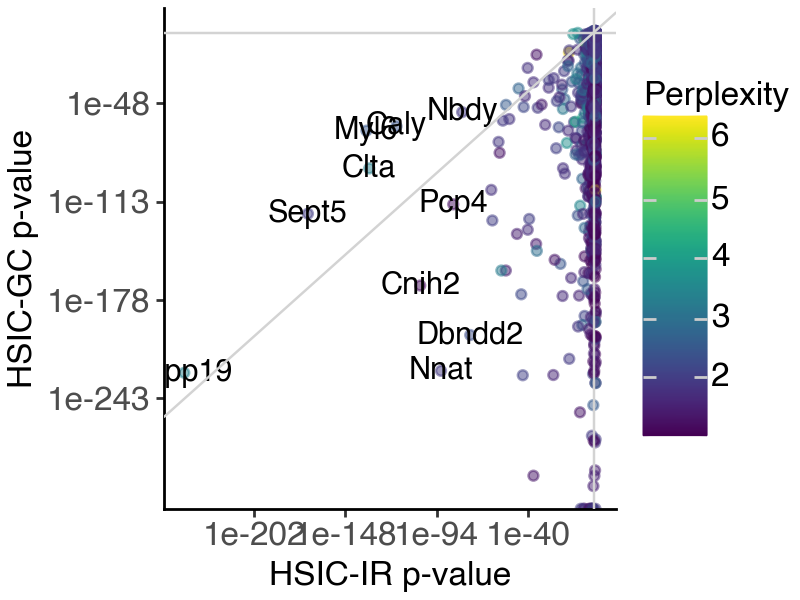

In [4]:
# _df = df_sv_cbs.loc[df_sv_cbs['is_ont_expressed']].reset_index(names = 'gene_symbol')
_df = df_sv_cbs.reset_index(names = 'gene_symbol')
(
    ggplot(_df, aes(x = 'pvalue_hsic-ir_2', y = 'pvalue_hsic-gc_2')) +
        geom_point(aes(color = 'perplexity_2'), alpha = 0.5) + 
        geom_text(
            _df.nsmallest(10, 'pvalue_hsic-ir_2').reset_index(),
            aes(label = 'gene_symbol')
        ) + 
        geom_hline(yintercept = 0.05, color = 'lightgray') + 
        geom_vline(xintercept = 0.05, color = 'lightgray') + 
        geom_abline(slope = 1, color = 'lightgray') + 
        labs(x = 'HSIC-IR p-value', y = 'HSIC-GC p-value', color = 'Perplexity') + 
        scale_x_log10() + 
        scale_y_log10() + 
        theme_classic() + 
        theme(figure_size=[4,3],
             text=element_text(size = 12))
)

/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10


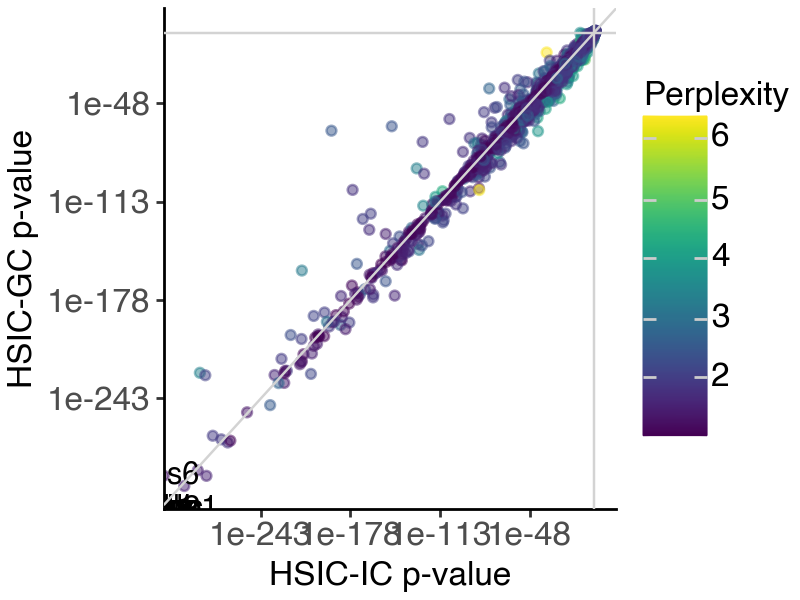

In [5]:
# _df = df_sv_cbs.loc[df_sv_cbs['is_ont_expressed']].reset_index(names = 'gene_symbol')
_df = df_sv_cbs.reset_index(names = 'gene_symbol')
(
    ggplot(_df, aes(x = 'pvalue_hsic-ic_2', y = 'pvalue_hsic-gc_2')) +
        geom_point(aes(color = 'perplexity_2'), alpha = 0.5) + 
        geom_text(
            _df.nsmallest(10, 'pvalue_hsic-ic_2').reset_index(),
            aes(label = 'gene_symbol')
        ) + 
        geom_hline(yintercept = 0.05, color = 'lightgray') + 
        geom_vline(xintercept = 0.05, color = 'lightgray') + 
        geom_abline(slope = 1, color = 'lightgray') + 
        labs(x = 'HSIC-IC p-value', y = 'HSIC-GC p-value', color = 'Perplexity') + 
        scale_x_log10() + 
        scale_y_log10() + 
        theme_classic() + 
        theme(figure_size=[4,3],
             text=element_text(size = 12))
)

/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10


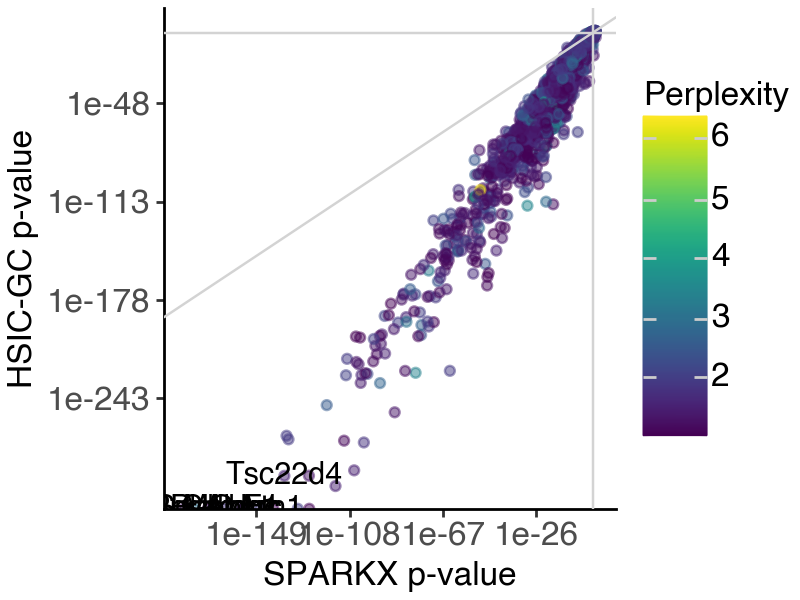

In [6]:
# _df = df_sv_cbs.loc[df_sv_cbs['is_ont_expressed']].reset_index(names = 'gene_symbol')
_df = df_sv_cbs.reset_index(names = 'gene_symbol')
(
    ggplot(_df, aes(x = 'pvalue_spark-x_2', y = 'pvalue_hsic-gc_2')) +
        geom_point(aes(color = 'perplexity_2'), alpha = 0.5) + 
        geom_text(
            _df.nsmallest(10, 'pvalue_spark-x_2').reset_index(),
            aes(label = 'gene_symbol')
        ) + 
        geom_hline(yintercept = 0.05, color = 'lightgray') + 
        geom_vline(xintercept = 0.05, color = 'lightgray') + 
        geom_abline(slope = 1, color = 'lightgray') + 
        labs(x = 'SPARKX p-value', y = 'HSIC-GC p-value', color = 'Perplexity') + 
        scale_x_log10() + 
        scale_y_log10() + 
        theme_classic() + 
        theme(figure_size=[4,3],
             text=element_text(size = 12))
)

#### SV results, CBS1 vs CBS2

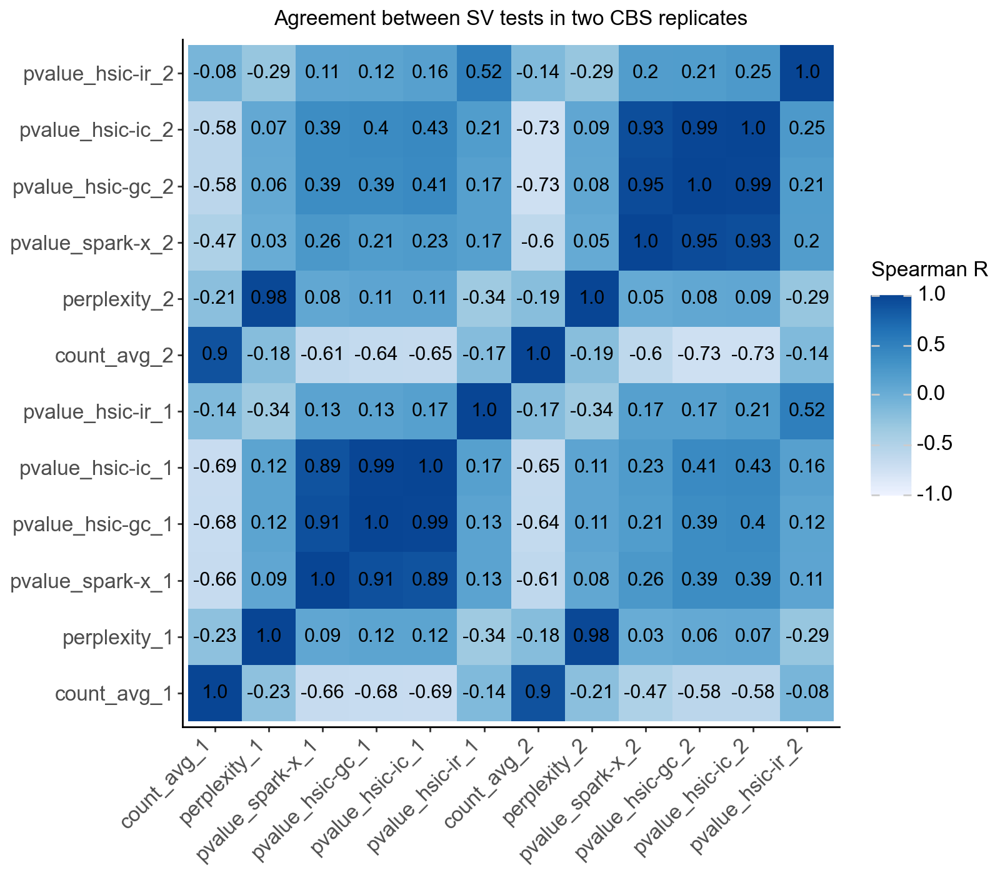

In [7]:
_cols_to_compare = [f"{_col}_{_s}" 
    for _s in ['1', '2']
    for _col in ['count_avg', 'perplexity', 'pvalue_spark-x', 'pvalue_hsic-gc', 'pvalue_hsic-ic', 'pvalue_hsic-ir']
]

# calculate Spearmann correlation across tests and samples
_df = df_sv_cbs.loc[df_sv_cbs['is_ont_expressed'], _cols_to_compare]
_conf_mat = pd.DataFrame(
    spearmanr(_df)[0], 
    columns = _df.columns, 
    index = _df.columns
).reset_index(names='id')
_conf_mat = pd.melt(_conf_mat, id_vars='id').round(2)

_conf_mat['id'] = pd.Categorical(_conf_mat['id'], ordered=True, categories=_cols_to_compare)
_conf_mat['variable'] = pd.Categorical(_conf_mat['variable'], ordered=True, categories=_cols_to_compare)

(
    ggplot(_conf_mat, aes(x = 'id', y = 'variable', fill = 'value')) + 
        geom_tile() + 
        geom_text(aes(label = 'value')) + 
        scale_fill_distiller(limits = (-1, 1), direction = 1) + 
        labs(x = '', y = '', fill = 'Spearman R', title = 'Agreement between SV tests in two CBS replicates') + 
        theme_classic() + 
        theme(
            figure_size=[8, 7],
            text = element_text(family='Arial', size = 12), 
            axis_text_x=element_text(rotation=45, hjust = 1, vjust = 1)
        )
)

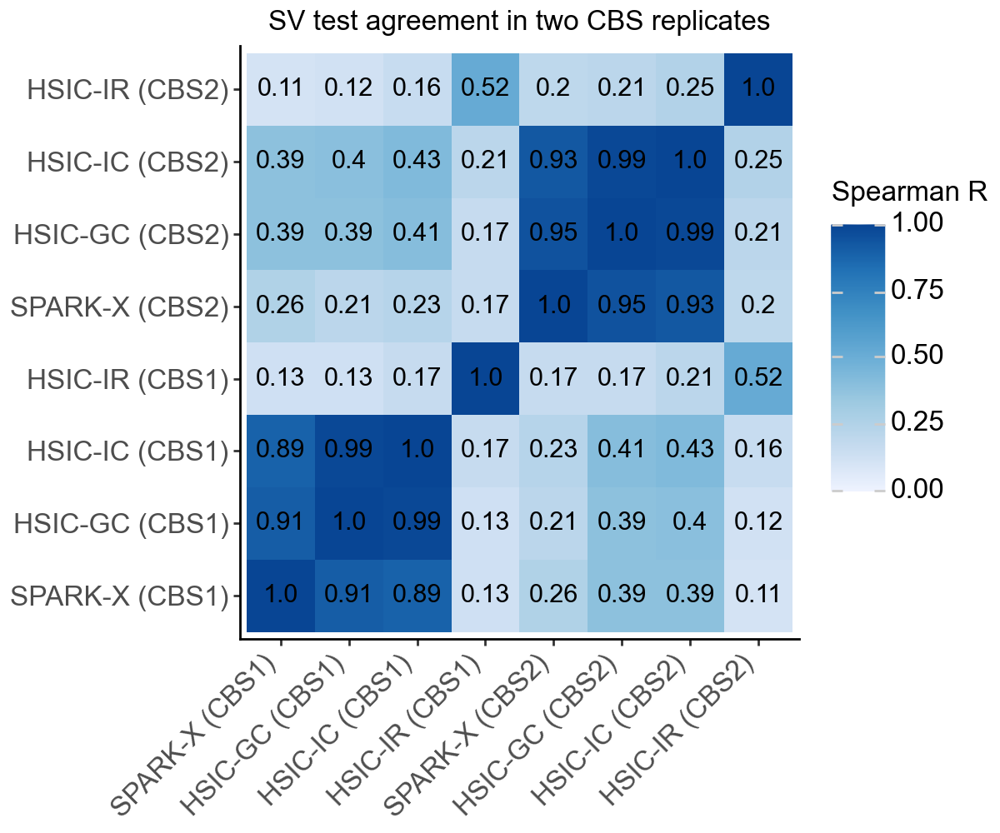

In [8]:
_cols_to_compare = [f"{_col}_{_s}" 
    for _s in ['1', '2']
    for _col in ['pvalue_spark-x', 'pvalue_hsic-gc', 'pvalue_hsic-ic', 'pvalue_hsic-ir']
]
_labels = [f"{_col} (CBS{_s})"
    for _s in ['1', '2']
    for _col in ['SPARK-X', 'HSIC-GC', 'HSIC-IC', 'HSIC-IR']
]

# calculate Spearmann correlation across tests and samples
_df = df_sv_cbs.loc[df_sv_cbs['is_ont_expressed'], _cols_to_compare]
_conf_mat = pd.DataFrame(
    spearmanr(_df)[0], 
    columns = _df.columns, 
    index = _df.columns
).reset_index(names='id')
_conf_mat = pd.melt(_conf_mat, id_vars='id').round(2)

_conf_mat['id'] = pd.Categorical(_conf_mat['id'], ordered=True, categories=_cols_to_compare).rename_categories(_labels)
_conf_mat['variable'] = pd.Categorical(_conf_mat['variable'], ordered=True, categories=_cols_to_compare).rename_categories(_labels)

(
    ggplot(_conf_mat, aes(x = 'id', y = 'variable', fill = 'value')) + 
        geom_tile() + 
        geom_text(aes(label = 'value')) + 
        scale_fill_distiller(limits = (0, 1), direction = 1) + 
        labs(x = '', y = '', fill = 'Spearman R', title = 'SV test agreement in two CBS replicates') + 
        theme_classic() + 
        theme(
            figure_size=[6, 5],
            text = element_text(family='Arial', size = 12), 
            axis_text_x=element_text(rotation=45, hjust = 1, vjust = 1)
        )
)

/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10


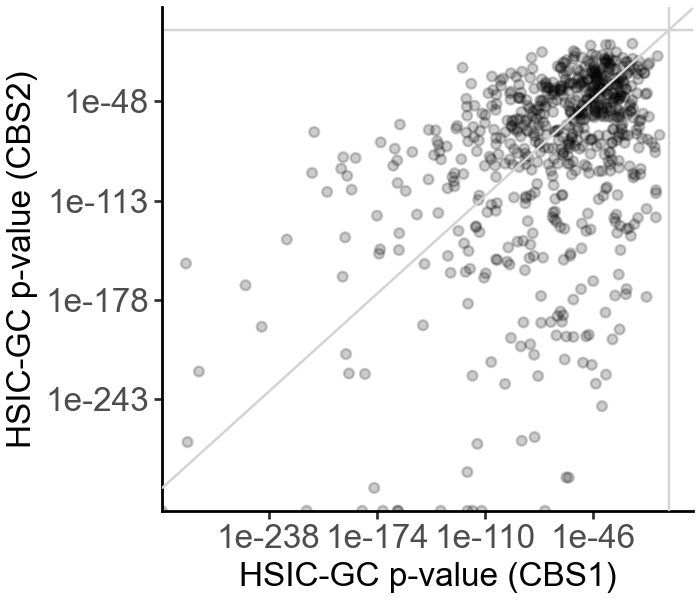

In [9]:
_df = df_sv_cbs.loc[df_sv_cbs['is_ont_expressed']].reset_index(names = 'gene_symbol')
# _df = df_sv_cbs.reset_index(names = 'gene_symbol')
(
    ggplot(_df, aes(x = 'pvalue_hsic-gc_1', y = 'pvalue_hsic-gc_2')) +
        # stat_density_2d(levels = 5) + 
        geom_point(alpha = 0.2) + 
        geom_hline(yintercept = 0.05, color = 'lightgray') + 
        geom_vline(xintercept = 0.05, color = 'lightgray') + 
        geom_abline(slope = 1, color = 'lightgray') + 
        labs(x = 'HSIC-GC p-value (CBS1)', y = 'HSIC-GC p-value (CBS2)') + 
        scale_x_log10() + 
        scale_y_log10() + 
        theme_classic() + 
        theme(figure_size=[3.5,3],
              text = element_text(family='Arial', size = 12))
)

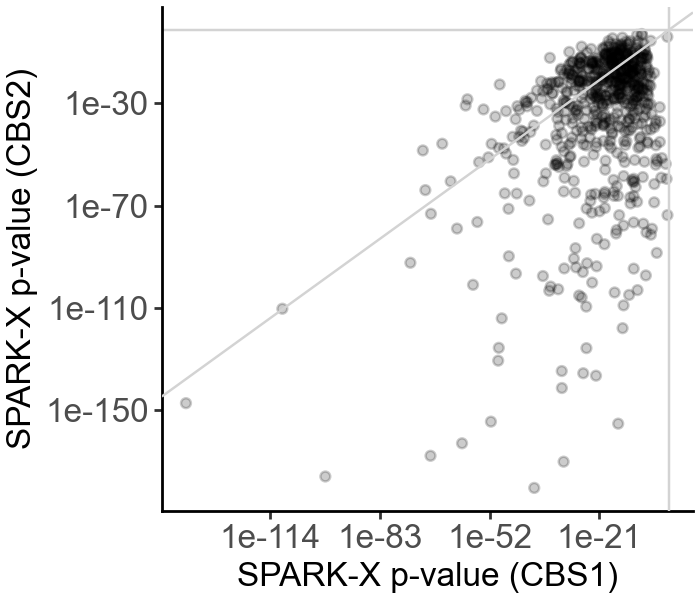

In [10]:
_df = df_sv_cbs.loc[df_sv_cbs['is_ont_expressed']].reset_index(names = 'gene_symbol')
# _df = df_sv_cbs.reset_index(names = 'gene_symbol')
(
    ggplot(_df, aes(x = 'pvalue_spark-x_1', y = 'pvalue_spark-x_2')) +
        geom_point(alpha = 0.2) + 
        geom_hline(yintercept = 0.05, color = 'lightgray') + 
        geom_vline(xintercept = 0.05, color = 'lightgray') + 
        geom_abline(slope = 1, color = 'lightgray') + 
        labs(x = 'SPARK-X p-value (CBS1)', y = 'SPARK-X p-value (CBS2)') + 
        scale_x_log10() + 
        scale_y_log10() + 
        theme_classic() + 
        theme(figure_size=[3.5,3],
              text = element_text(family='Arial', size = 12))
)

/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10


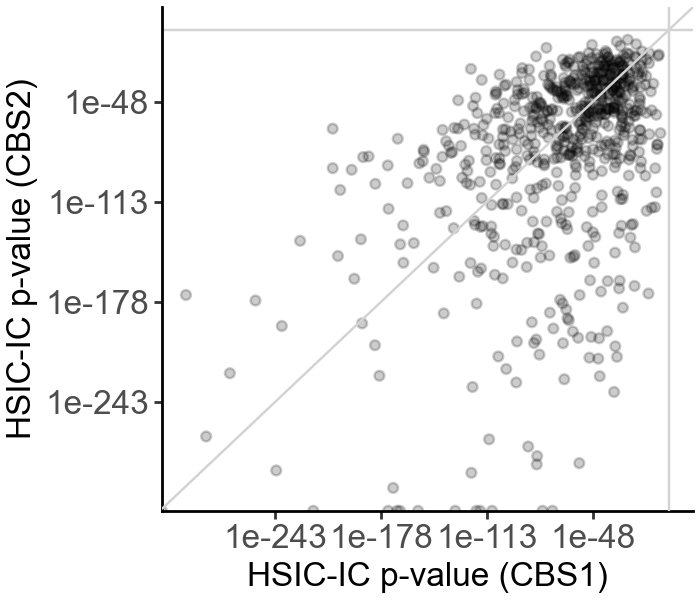

In [11]:
_df = df_sv_cbs.loc[df_sv_cbs['is_ont_expressed']].reset_index(names = 'gene_symbol')
# _df = df_sv_cbs.reset_index(names = 'gene_symbol')
(
    ggplot(_df, aes(x = 'pvalue_hsic-ic_1', y = 'pvalue_hsic-ic_2')) +
        # stat_density_2d(levels = 5) + 
        geom_point(alpha = 0.2) + 
        geom_hline(yintercept = 0.05, color = 'lightgray') + 
        geom_vline(xintercept = 0.05, color = 'lightgray') + 
        geom_abline(slope = 1, color = 'lightgray') + 
        labs(x = 'HSIC-IC p-value (CBS1)', y = 'HSIC-IC p-value (CBS2)') + 
        scale_x_log10() + 
        scale_y_log10() + 
        theme_classic() + 
        theme(figure_size=[3.5,3],
              text = element_text(family='Arial', size = 12))
)

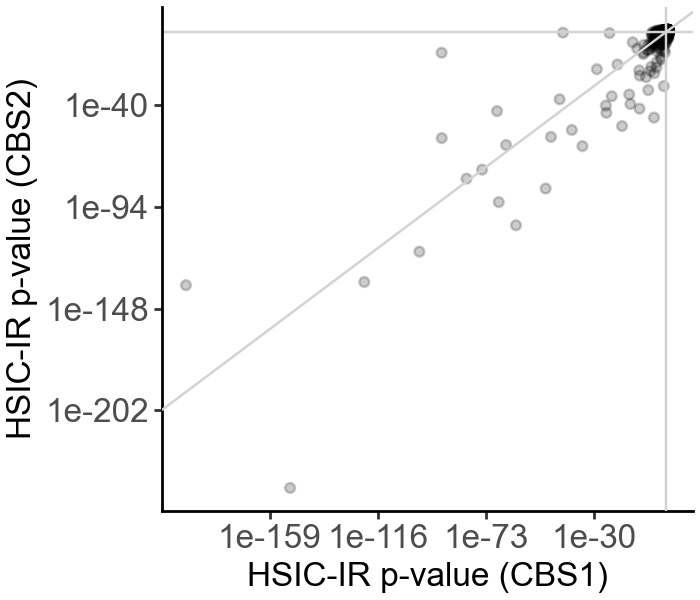

In [12]:
_df = df_sv_cbs.loc[df_sv_cbs['is_ont_expressed']].reset_index(names = 'gene_symbol')
# _df = df_sv_cbs.reset_index(names = 'gene_symbol')
(
    ggplot(_df, aes(x = 'pvalue_hsic-ir_1', y = 'pvalue_hsic-ir_2')) +
        # stat_density_2d(levels = 5) + 
        geom_point(alpha = 0.2) + 
        geom_hline(yintercept = 0.05, color = 'lightgray') + 
        geom_vline(xintercept = 0.05, color = 'lightgray') + 
        geom_abline(slope = 1, color = 'lightgray') + 
        labs(x = 'HSIC-IR p-value (CBS1)', y = 'HSIC-IR p-value (CBS2)') + 
        scale_x_log10() + 
        scale_y_log10() + 
        theme_classic() + 
        theme(figure_size=[3.5,3],
              text = element_text(family='Arial', size = 12))
)

#### ONT expression of SV genes, CBS2

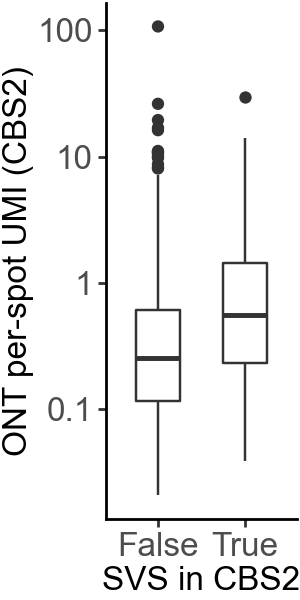

In [13]:
_df = df_sv_cbs.reset_index(names = 'gene_symbol')
(
    ggplot(_df, aes(x = 'is_ont_svs_2', y = 'count_avg_2')) + 
        geom_boxplot(width = 0.5) + 
        scale_y_log10() + 
        labs(x = 'SVS in CBS2', y = 'ONT per-spot UMI (CBS2)') + 
        # scale_fill_manual(values={True: _pal['svs'], False: _pal['not_svs']}) + 
        theme_classic() + 
        theme(
            figure_size=[1.5, 3],
            text = element_text(family='arial', size = 12),
            legend_position='none'
        )
)

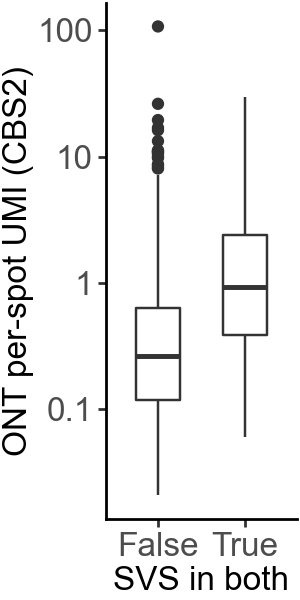

In [14]:
# _df = df_sv_cbs.loc[df_sv_cbs['is_ont_expressed']].reset_index(names = 'gene_symbol')
_df = df_sv_cbs.reset_index(names = 'gene_symbol')
(
    ggplot(_df, aes(x = 'is_ont_svs', y = 'count_avg_2')) + 
        geom_boxplot(width = 0.5) + 
        scale_y_log10() + 
        labs(x = 'SVS in both', y = 'ONT per-spot UMI (CBS2)') + 
        # scale_fill_manual(values={True: _pal['svs'], False: _pal['not_svs']}) + 
        theme_classic() + 
        theme(
            figure_size=[1.5, 3],
            text = element_text(family='arial', size = 12),
            legend_position='none'
        )
)

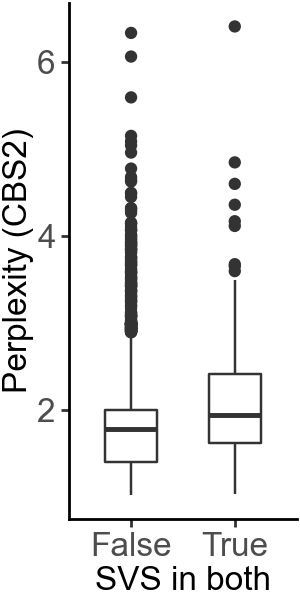

In [15]:
# _df = df_sv_cbs.loc[df_sv_cbs['is_ont_expressed']].reset_index(names = 'gene_symbol')
_df = df_sv_cbs.reset_index(names = 'gene_symbol')
(
    ggplot(_df, aes(x = 'is_ont_svs', y = 'perplexity_2')) + 
        geom_boxplot(width = 0.5) + 
        # scale_y_log10() + 
        labs(x = 'SVS in both', y = 'Perplexity (CBS2)') + 
        theme_classic() + 
        theme(
            figure_size=[1.5, 3],
            text = element_text(family='arial', size = 12),
            legend_position='none'
        )
)

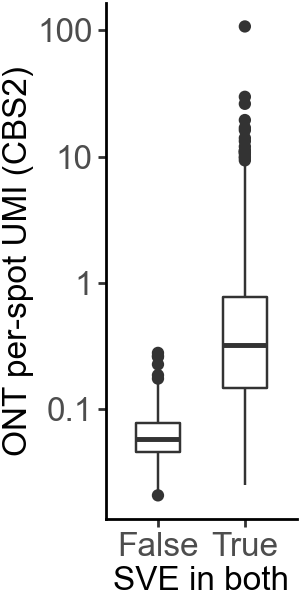

In [16]:
# _df = df_sv_cbs.loc[df_sv_cbs['is_ont_expressed']].reset_index(names = 'gene_symbol')
_df = df_sv_cbs.reset_index(names = 'gene_symbol')
(
    ggplot(_df, aes(x = 'is_ont_sve', y = 'count_avg_2')) + 
        geom_boxplot(width = 0.5) + 
        scale_y_log10() + 
        labs(x = 'SVE in both', y = 'ONT per-spot UMI (CBS2)') + 
        # scale_fill_manual(values={True: _pal['svs'], False: _pal['not_svs']}) + 
        theme_classic() + 
        theme(
            figure_size=[1.5, 3],
            text = element_text(family='arial', size = 12),
            legend_position='none'
        )
)

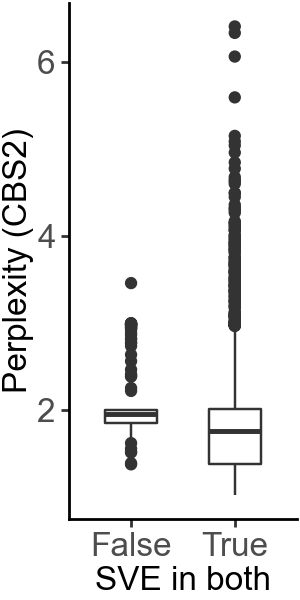

In [17]:
# _df = df_sv_cbs.loc[df_sv_cbs['is_ont_expressed']].reset_index(names = 'gene_symbol')
_df = df_sv_cbs.reset_index(names = 'gene_symbol')
(
    ggplot(_df, aes(x = 'is_ont_sve', y = 'perplexity_2')) + 
        geom_boxplot(width = 0.5) + 
        # scale_y_log10() + 
        labs(x = 'SVE in both', y = 'Perplexity (CBS2)') + 
        theme_classic() + 
        theme(
            figure_size=[1.5, 3],
            text = element_text(family='arial', size = 12),
            legend_position='none'
        )
)

#### ONT expression, CBS1 vs CBS2

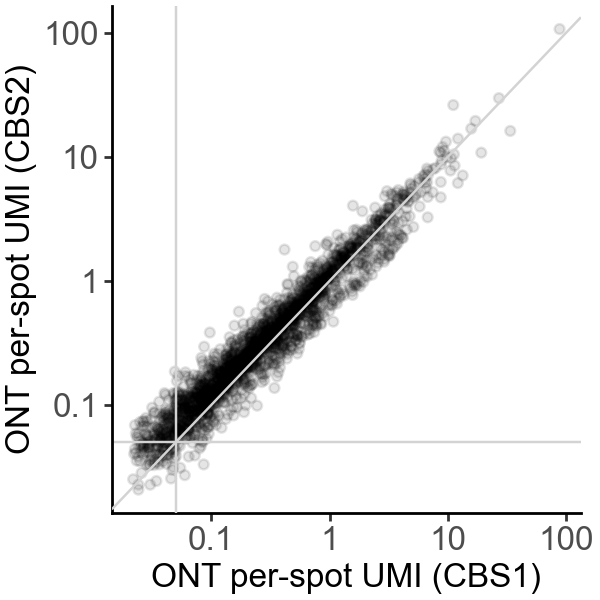

In [18]:
# _df = df_sv_cbs.loc[df_sv_cbs['is_ont_expressed']].reset_index(names = 'gene_symbol')
_df = df_sv_cbs.reset_index(names = 'gene_symbol')
(
    ggplot(_df, aes(x = 'count_avg_1', y = 'count_avg_2')) +
        # stat_density_2d(levels = 5) + 
        geom_point(alpha = 0.1) + 
        geom_hline(yintercept = 0.05, color = 'lightgray') + 
        geom_vline(xintercept = 0.05, color = 'lightgray') + 
        geom_abline(slope = 1, color = 'lightgray') + 
        labs(x = 'ONT per-spot UMI (CBS1)', y = 'ONT per-spot UMI (CBS2)') + 
        scale_x_log10() + 
        scale_y_log10() + 
        theme_classic() + 
        theme(figure_size=[3,3],
              text = element_text(family='Arial', size = 12))
)

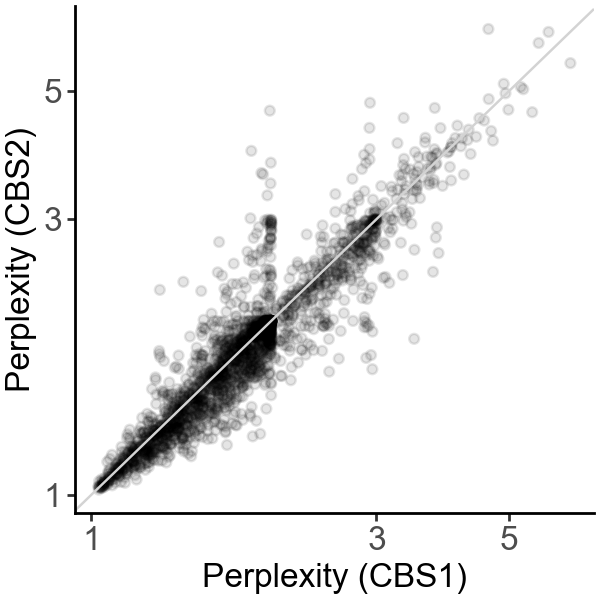

In [19]:
# _df = df_sv_cbs.loc[df_sv_cbs['is_ont_expressed']].reset_index(names = 'gene_symbol')
_df = df_sv_cbs.reset_index(names = 'gene_symbol')
(
    ggplot(_df, aes(x = 'perplexity_1', y = 'perplexity_2')) +
        # stat_density_2d(levels = 5) + 
        geom_point(alpha = 0.1) + 
        geom_abline(slope = 1, color = 'lightgray') + 
        labs(x = 'Perplexity (CBS1)', y = 'Perplexity (CBS2)') + 
        scale_x_log10() + 
        scale_y_log10() + 
        theme_classic() + 
        theme(figure_size=[3,3],
              text = element_text(family='Arial', size = 12))
)

### Functional enrichment analysis

In [20]:
def get_enrich_res(
    svs_gene_list,
    svens_gene_list,
    sources_list = ['GO:BP'],
    topk = 20,
    return_enr_res = False
):
    # run enrichment analysis
    enr_svs = sc.queries.enrich(
        svs_gene_list, org="mmusculus", 
        gprofiler_kwargs = {'all_results': True, 'sources': sources_list},
    )
    enr_svens = sc.queries.enrich(
        svens_gene_list, org="mmusculus", 
        gprofiler_kwargs = {'all_results': True, 'sources': sources_list},
    )

    # extract significant positive and negative functional terms
    _top_term_svs = enr_svs.loc[enr_svs['significant'], 'native'].to_list()
    _top_go_svens = enr_svens.loc[enr_svens['significant'], 'native'].to_list()
    
    # combine results
    df_term = pd.concat([
        enr_svs.loc[
            enr_svs['native'].isin(_top_term_svs + _top_go_svens),
            # ['source', 'native', 'name', 'description', 'term_size']
        ].assign(geneset = 'SVS'),
        enr_svens.loc[
            enr_svens['native'].isin(_top_term_svs + _top_go_svens),
            # ['source', 'native', 'name', 'description', 'term_size']
        ].assign(geneset = 'SVE'),
    ])
    
    # calculated precision differences
    unstacked = df_term.groupby(['native', 'geneset'])['precision'].mean().unstack()
    unstacked['precision_diff'] = unstacked['SVS'] - unstacked['SVE']
    df_term = df_term.merge(unstacked[['precision_diff']], on='native', how='left')
    
    # sort terms by the precision difference and keep top terms
    _order1 = df_term.sort_values('precision_diff', ascending=True).head(topk)['name'].unique().tolist()
    _order2 = df_term.sort_values('precision_diff', ascending=False).head(topk)['name'].unique().tolist()
    df_term = df_term.loc[df_term['name'].isin(_order1 + _order2)]

    # sort resulting dataframe by precision difference
    df_term.sort_values(by = 'precision_diff', inplace = True)
    df_term['name_cat'] = pd.Categorical(df_term['name'], ordered=True, categories=df_term['name'].unique())

    if not return_enr_res:
        return df_term
    else:
        return df_term, enr_svs, enr_svens

In [21]:
# _df = df_sv_cbs.loc[df_sv_cbs['is_ont_expressed']].copy()
_df = df_sv_cbs.copy()
print(_df.groupby(['is_ont_svs', 'is_ont_sve']).size())

# define the gene lists to compare
svs_gene_list = _df.index[_df['is_ont_svs']].to_list()
svens_gene_list = _df.index[(~ _df['is_ont_svs']) & (_df['is_ont_sve'])].to_list()

is_ont_svs  is_ont_sve
False       False          165
            True          1893
True        False            1
            True           149
dtype: int64


#### Gene Ontology Enrichment

In [22]:
df_go = get_enrich_res(svs_gene_list, svens_gene_list, sources_list=['GO:BP'], topk=20)
df_go['name_cat'] = pd.Categorical(
    df_go['name_cat'].str.capitalize(), 
    ordered = True, categories=df_go['name_cat'].str.capitalize().unique()
)

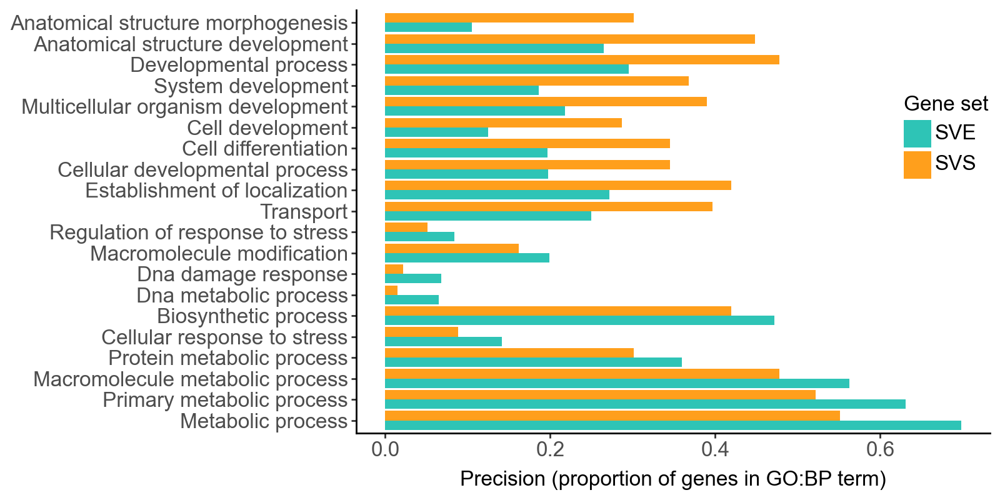

In [23]:
(
    ggplot(df_go, aes(x = 'name_cat', y = 'precision', group = 'geneset', fill = 'geneset')) + 
        geom_bar(stat='identity', position='dodge') + 
        labs(y = 'Precision (proportion of genes in GO:BP term)', x = '', fill = 'Gene set') + 
        coord_flip() + 
        scale_fill_manual(values={'SVS': '#FF9F1C', 'SVE': '#2EC4B6'}) + 
        theme_classic() + 
        theme(
            figure_size=(8,4),
            text=element_text(size = 12, family = 'Arial'),
            legend_position='inside',
            legend_position_inside = (1,0.75)
        )
)

#### KEGG Enrichment

In [24]:
df_kegg = get_enrich_res(svs_gene_list, svens_gene_list, sources_list=['KEGG'], topk=20)

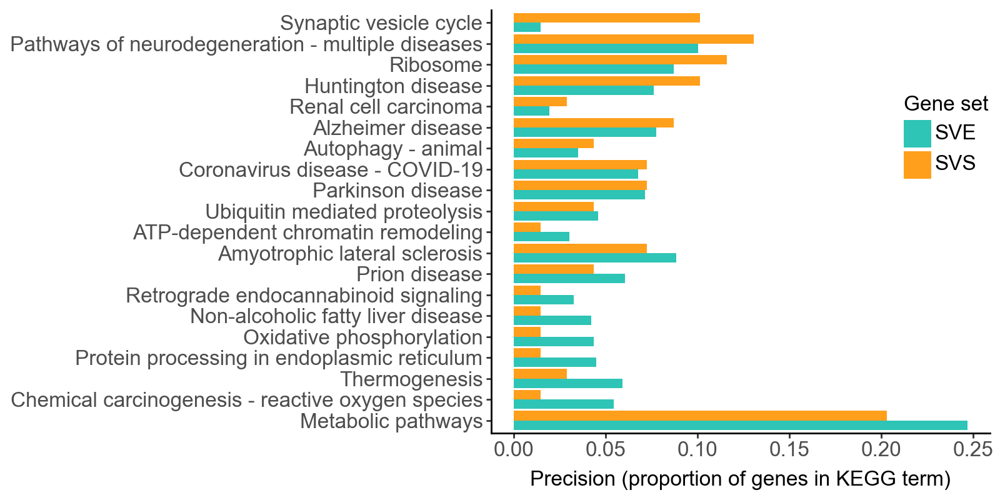

In [25]:
(
    ggplot(df_kegg, aes(x = 'name_cat', y = 'precision', group = 'geneset', fill = 'geneset')) + 
        geom_bar(stat='identity', position='dodge') + 
        labs(y = 'Precision (proportion of genes in KEGG term)', x = '', fill = 'Gene set') + 
        coord_flip() + 
        scale_fill_manual(values={'SVS': '#FF9F1C', 'SVE': '#2EC4B6'}) + 
        theme_classic() + 
        theme(
            figure_size=(8,4),
            text=element_text(size = 12, family = 'Arial'),
            legend_position='inside',
            legend_position_inside = (1,0.75)
        )
)

#### Reactome Enrichment

In [26]:
df_reac = get_enrich_res(svs_gene_list, svens_gene_list, sources_list=['REAC'], topk=20)

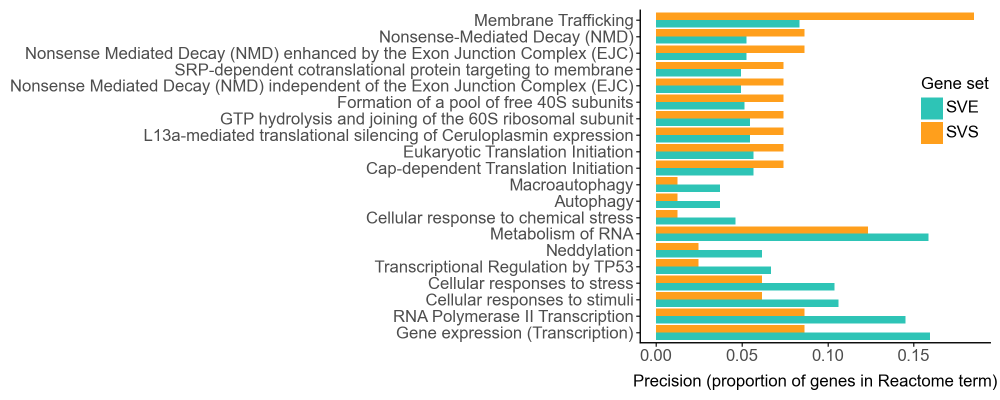

In [27]:
(
    ggplot(df_reac, aes(x = 'name_cat', y = 'precision', group = 'geneset', fill = 'geneset')) + 
        geom_bar(stat='identity', position='dodge') + 
        labs(y = 'Precision (proportion of genes in Reactome term)', x = '', fill = 'Gene set') + 
        coord_flip() + 
        scale_fill_manual(values={'SVS': '#FF9F1C', 'SVE': '#2EC4B6'}) + 
        theme_classic() + 
        theme(
            figure_size=(10,4),
            text=element_text(size = 12, family = 'Arial'),
            legend_position='inside',
            legend_position_inside = (1,0.75)
        )
)

## Prepare anndata with SV results

In [28]:
from smoother import SpatialWeightMatrix
from isosde.utils import extract_counts_n_ratios

# helper function to calculate smoothed counts and ratios
def calc_smoothed_counts_n_ratios(adata, p = 0.2):
    # compute spatial knn graph
    coords = adata.obs.loc[:, ['array_row', 'array_col']]
    swm = SpatialWeightMatrix()
    swm.calc_weights_knn(coords, k = 6)

    # compute locally smoothed isoform counts
    scaling = swm.swm.to_dense() * p + torch.eye(adata.shape[0]) * (1 - p) # (n_spots, n_spots)
    adata.layers['counts_smoothed'] = scaling.numpy() @ adata.layers['counts'] # (n_spots, n_total_isos)
    
    # calculate usage ratio from counts
    _, _, _, _ratio_merged = extract_counts_n_ratios(adata, layer = 'counts_smoothed', group_iso_by = 'gene_symbol')
    adata.layers['ratios_smoothed'] = _ratio_merged # (n_spots, n_total_isos)

    return adata

### Load and prepare anndata

#### Load Visium RBP anndata

In [29]:
# load the visium rbp count data
adata_visium_rbp = sc.read_h5ad(f"{res_dir}/anndata/cbs2_visium_rbp_{date}.h5ad")
adata_visium_rbp.var.groupby(['is_rbp', 'is_visium_sve']).size()

is_rbp  is_visium_sve
True    False             386
        True             1028
dtype: int64

#### Load ONT anndata and compute smoothed ratios

In [30]:
# load the ONT count data
adata_ont = sc.read_h5ad(f"{res_dir}/anndata/cbs2_ont_filtered_{date}.h5ad")

# compute smoothed read counts
adata_ont = calc_smoothed_counts_n_ratios(adata_ont, p = 0.2)
adata_ont

Number of spots: 2500. Average number of neighbors per spot:  6.00.


AnnData object with n_obs × n_vars = 2500 × 6480
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'region', 'AtoI_total', 'AtoI_ratio', 'AtoI_detected', 'in_tissue', 'array_row', 'array_col'
    var: 'features', 'n_cells', 'gene_symbol', 'transcript_id', 'transcript_name'
    uns: 'log1p', 'spatial'
    obsm: 'spatial'
    layers: 'counts', 'log1p', 'ratios_obs', 'counts_smoothed', 'ratios_smoothed'

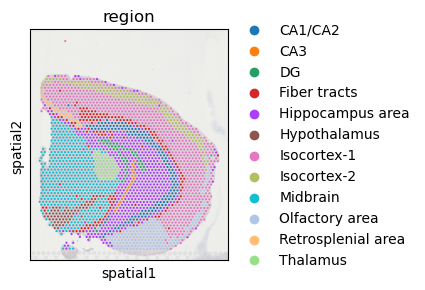

In [31]:
with plt.rc_context({"figure.figsize": (3, 3)}):
    sc.pl.spatial(adata_ont, color = ['region'], img_key = 'lowres', alpha_img=0.3)

In [32]:
# focus on expressed SVS genes only
_iso_ind = adata_ont.var['gene_symbol'].isin(
    # df_sv_cbs.loc[df_sv_cbs['is_ont_svs'] & df_sv_cbs['is_ont_expressed']].index
    df_sv_cbs2.loc[df_sv_cbs2['is_ont_svs'] & df_sv_cbs2['is_ont_expressed']].index
)
adata_ont_sv = adata_ont[:, _iso_ind].copy()

#### Load GLMM fitting results

In [33]:
# load fitted GLMM model and extract inferred isoform ratio
glmm = torch.load(f"{res_dir}/model/cbs2_glmm_{date}.pkl")
glmm_model_list = glmm.get_fitted_models()

In [34]:
# extract estimated ratio
iso_ind_list = []

for i, (_gene, _group) in enumerate(adata_ont_sv.var.reset_index().groupby('gene_symbol')):
    assert glmm.gene_names[i] == _gene
    # extract isoform index per gene
    iso_ind_list.append(_group.index.tolist())

ratio_fitted_list = [_m.get_isoform_ratio().squeeze() for _m in glmm_model_list]

# reshape and store the fitted ratio in anndata
ratio_fitted_merged = torch.concat(ratio_fitted_list, axis = 1).numpy()
ratio_fitted_merged = ratio_fitted_merged[:, np.argsort(np.concatenate(iso_ind_list))]

adata_ont_sv.layers['ratios_glmm'] = ratio_fitted_merged.copy()

/var/folders/_f/m4v2g8c54gdfks59bp2f2cm80000gn/T/ipykernel_65340/801697142.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


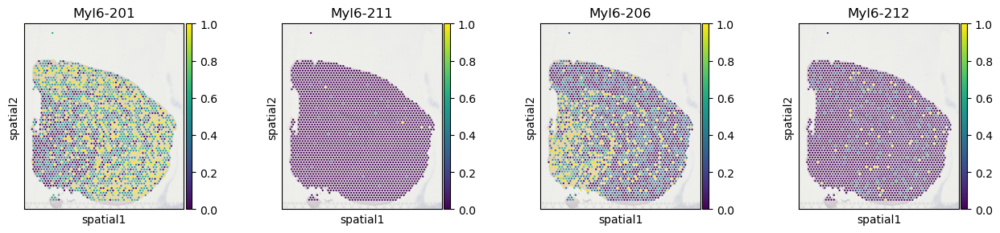

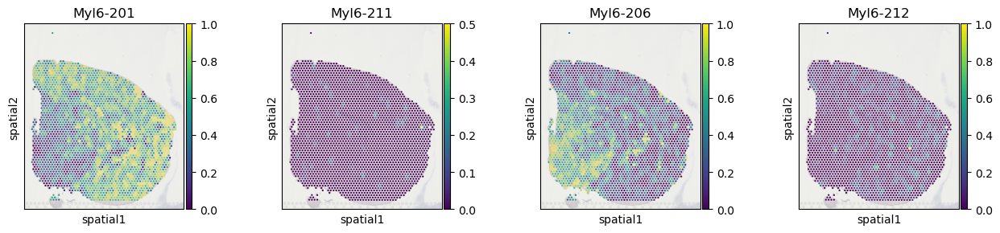

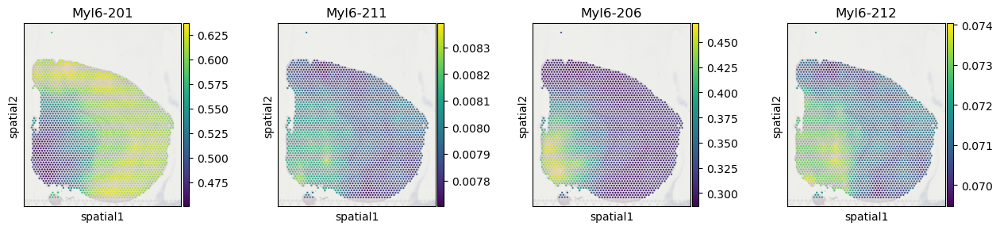

In [35]:
_iso_to_plot = adata_ont_sv.var.index[adata_ont_sv.var['gene_symbol'] == 'Myl6']
_name_to_plot = adata_ont_sv.var.loc[adata_ont_sv.var['gene_symbol'] == 'Myl6', 'transcript_name']
with plt.rc_context({"figure.figsize": (3, 3)}):
    sc.pl.spatial(adata_ont_sv, color = _iso_to_plot, title = _name_to_plot,
                  img_key = 'lowres', alpha_img=0.3, layer = 'ratios_obs', ncols = len(_iso_to_plot))
    sc.pl.spatial(adata_ont_sv, color = _iso_to_plot, title = _name_to_plot,
                  img_key = 'lowres', alpha_img=0.3, layer = 'ratios_smoothed', ncols = len(_iso_to_plot))
    sc.pl.spatial(adata_ont_sv, color = _iso_to_plot, title = _name_to_plot,
                  img_key = 'lowres', alpha_img=0.3, layer = 'ratios_glmm', ncols = len(_iso_to_plot))

### Clustering spots

#### Cluster by gene expression

In [36]:
# focus on expressed SVE genes only
_iso_ind = adata_ont.var['gene_symbol'].isin(
    # df_sv_cbs.loc[df_sv_cbs['is_ont_sve'] & df_sv_cbs['is_ont_expressed']].index
    df_sv_cbs.loc[df_sv_cbs['is_ont_sve']].index
     # df_sv_cbs.loc[df_sv_cbs['is_ont_sve']].sort_values('pvalue_hsic-gc_2').head(2000).index
)
_data = adata_ont[:, _iso_ind].copy()

# calculate the total counts per gene
_mapping_matrix = pd.get_dummies(_data.var['gene_symbol'])
_isog_counts = _data[:, _mapping_matrix.index].layers['counts_smoothed'] @ _mapping_matrix
# _isog_counts = _data[:, _mapping_matrix.index].layers['counts'] @ _mapping_matrix

# create anndata obj
_data = sc.AnnData(
    _isog_counts,
    obs = adata_ont.obs
)

# log normalization
sc.pp.normalize_total(_data, target_sum=1e4)
sc.pp.log1p(_data)
_data.layers['log1p'] = _data.X.copy()

# pca and clustering
sc.tl.pca(_data, layer = 'log1p')
sc.pp.neighbors(_data)
sc.tl.leiden(_data, resolution=0.35, flavor='igraph', n_iterations=2, key_added='ont_sve')

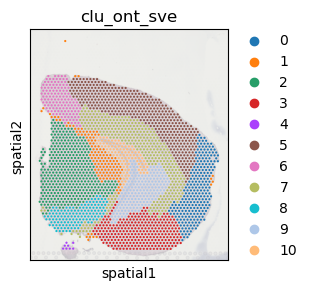

In [37]:
# store clustering results to the reference adata
adata_ont_sv.obs['clu_ont_sve'] = _data.obs['ont_sve']

with plt.rc_context({"figure.figsize": (3, 3)}):
    sc.pl.spatial(adata_ont_sv, color = ['clu_ont_sve'], img_key = 'lowres', alpha_img=0.3)

#### Cluster by observed (and smoothed) isoform ratio

In [38]:
# focus on expressed SVS genes only
# _data = adata_ont_sv.copy()
# focus on expressed SVE genes only
_iso_ind = adata_ont.var['gene_symbol'].isin(
     df_sv_cbs.loc[df_sv_cbs['is_ont_svs']].index
)
_data = adata_ont[:, _iso_ind].copy()
# _data = calc_smoothed_counts_n_ratios(_data, p = 0.2)

# pca and clustering
sc.tl.pca(_data, layer = 'ratios_smoothed')
sc.pp.neighbors(_data)
sc.tl.leiden(_data, resolution=0.8, flavor='igraph', n_iterations=2, key_added='ont_svs')

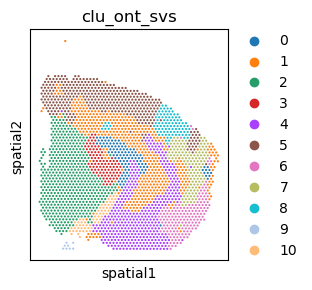

In [39]:
# store clustering results to the reference adata
adata_ont_sv.obs['clu_ont_svs'] = _data.obs['ont_svs']

with plt.rc_context({"figure.figsize": (3, 3)}):
    sc.pl.spatial(adata_ont_sv, color = ['clu_ont_svs'], img_key = 'lowres', alpha_img=0.0)

#### Cluster by RBP visium expression

In [42]:
# focus on expressed SVE genes only
_data = adata_visium_rbp[:, adata_visium_rbp.var['is_visium_sve']].copy()

# create anndata obj
_data = sc.AnnData(
    _data.layers['counts'],
    obs = adata_ont.obs
)

# log normalization
sc.pp.normalize_total(_data, target_sum=1e4)
sc.pp.log1p(_data)
_data.layers['log1p'] = _data.X.copy()

# pca and clustering
sc.tl.pca(_data, layer = 'log1p')
sc.pp.neighbors(_data)
sc.tl.leiden(_data, resolution=1.4, flavor='igraph', n_iterations=2, key_added='visium_rbp_sve')

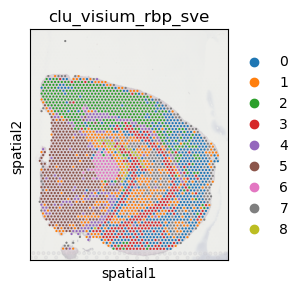

In [43]:
# store clustering results to the reference adata
adata_ont_sv.obs['clu_visium_rbp_sve'] = _data.obs['visium_rbp_sve']

with plt.rc_context({"figure.figsize": (3, 3)}):
    sc.pl.spatial(adata_ont_sv, color = ['clu_visium_rbp_sve'], img_key = 'lowres', alpha_img=0.3)

#### Combinded visualization

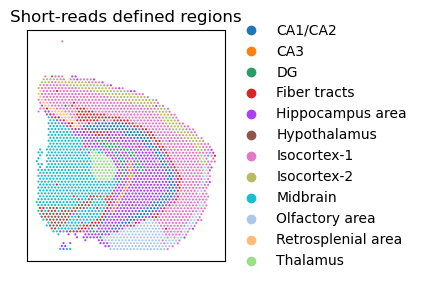

In [44]:
with plt.rc_context({"figure.figsize": (3, 3)}):
    axes = sc.pl.spatial(
        adata_ont_sv, color = ['region'], 
        title = ['Short-reads defined regions'],
        img_key = 'lowres', alpha_img=0.0, wspace = 0,
        show = False
    )
    for _ax in axes:
        _ax.set_xlabel('')
        _ax.set_ylabel('')
        
    plt.show()

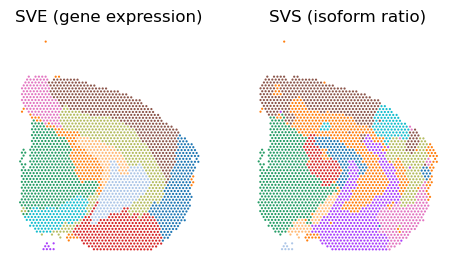

In [45]:
with plt.rc_context({"figure.figsize": (3, 3)}):
    axes = sc.pl.spatial(
        adata_ont_sv, color = ['clu_ont_sve', 'clu_ont_svs'], 
        title = ['SVE (gene expression)', 'SVS (isoform ratio)'],
        legend_loc = 'none',
        img_key = 'lowres', alpha_img=0.0, wspace = 0,
        show = False, frameon = False,
    )
    for _ax in axes:
        _ax.set_xlabel('')
        _ax.set_ylabel('')
        
    plt.show()

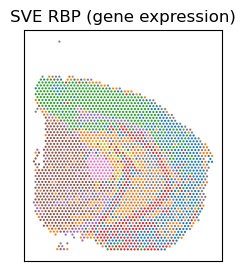

In [46]:
with plt.rc_context({"figure.figsize": (3, 3)}):
    axes = sc.pl.spatial(
        adata_ont_sv, color = ['clu_visium_rbp_sve'], 
        title = ['SVE RBP (gene expression)'],
        legend_loc = 'none',
        img_key = 'lowres', alpha_img=0, wspace = 0,
        show = False, frameon = True,
    )
    for _ax in axes:
        _ax.set_xlabel('')
        _ax.set_ylabel('')
        
    plt.show()

### Clustering SVS genes

In [47]:
from scipy.stats import pearsonr

def RVcoeff(dataList):
    """
    This function computes the RV matrix correlation coefficients between pairs
    of arrays. The number and order of objects (rows) for the two arrays must
    match. The number of variables in each array may vary.

    PARAMETERS
    ----------
    dataList : list
        A list holding numpy arrays for which the RV coefficient will be computed.

    RETURNS
    -------
    numpy array
        A numpy array holding RV coefficients for pairs of numpy arrays. The
        diagonal in the result array holds ones, since RV is computed on
        identical arrays, i.e. first array in ``dataList`` against frist array
        in
    """

    # Centering columns for each data x
    dataList = [data.numpy() if isinstance(data, torch.Tensor) else data for data in dataList]
    dataList = [data - np.mean(data, axis=0, keepdims = True) for data in dataList]
    
    # Compute the scalar sqrt(tr(xTx)) for each data x
    scalArrList = [np.linalg.norm(x.T @ x, ord = 'fro') for x in dataList]

    # Compute the pairwise RV coefficient
    C = np.eye(len(dataList))

    # Fill the upper triangle
    for i in range(len(dataList)):
        for j in range(i, len(dataList)):
            xTy = dataList[i].T @ dataList[j]
            C[i, j] = (np.linalg.norm(xTy, ord = 'fro') ** 2) / (scalArrList[i] * scalArrList[j])

    # Make it squareform
    for i in range(len(dataList)):
        for j in range(i):
            C[i, j] = C[j, i]

    return C

# x = np.random.rand(100, 2)
# y = np.random.rand(100, 3)
# z = np.random.rand(100, 4)

# RVcoeff([x, y, z])

#### Compute and visualize RV coefficients

In [48]:
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.cluster.hierarchy import linkage, fcluster, dendrogram
from sklearn.manifold import MDS

In [49]:
counts_list, ratios_list, gene_name_list, _ = extract_counts_n_ratios(
    adata_ont_sv, layer = 'counts', group_iso_by = 'gene_symbol'
)
counts_smoothed_list, ratios_smoothed_list, _, _ = extract_counts_n_ratios(
    adata_ont_sv, layer = 'counts_smoothed', group_iso_by = 'gene_symbol'
)

rvcoef_ratio = RVcoeff(ratios_list)
rvcoef_ratio_smoothed = RVcoeff(ratios_smoothed_list)

/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


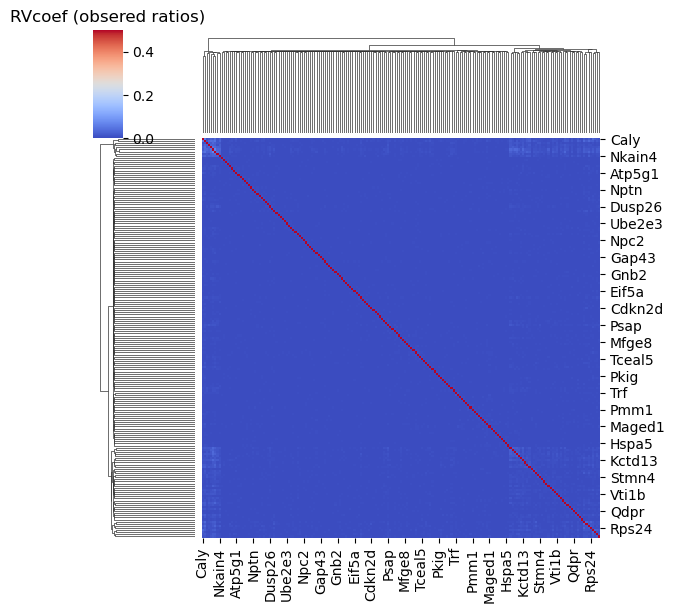

In [50]:
df_cor = pd.DataFrame(rvcoef_ratio, index=gene_name_list, columns=gene_name_list)

# Create a heatmap for the correlation matrix
sns.clustermap(
    df_cor,
    method="ward",  # Hierarchical clustering method
    metric="euclidean",  # Distance metric
    cmap="coolwarm",  # Color map
    annot=False,  # Annotate with correlation values
    vmin=0, vmax=0.5,
    figsize=(6, 6)
)

# Add title and axis labels
plt.title("RVcoef (obsered ratios)", fontsize=12)
plt.show()

/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


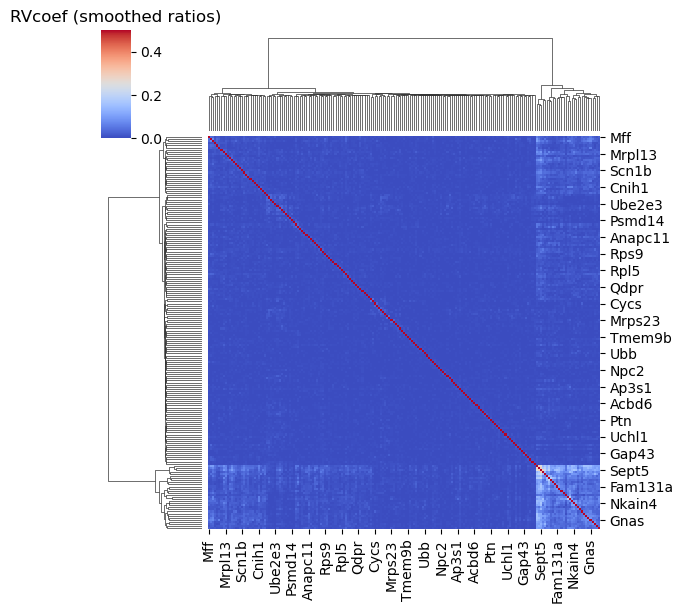

In [51]:
df_cor = pd.DataFrame(rvcoef_ratio_smoothed, index=gene_name_list, columns=gene_name_list)

# Create a heatmap for the correlation matrix
sns.clustermap(
    df_cor,
    method="ward",  # Hierarchical clustering method
    metric="euclidean",  # Distance metric
    cmap="coolwarm",  # Color map
    annot=False,  # Annotate with correlation values
    vmin=0, vmax=0.5,
    figsize=(6, 6)
)

# Add title and axis labels
plt.title("RVcoef (smoothed ratios)", fontsize=12)
plt.show()

#### Hierarchical clustering

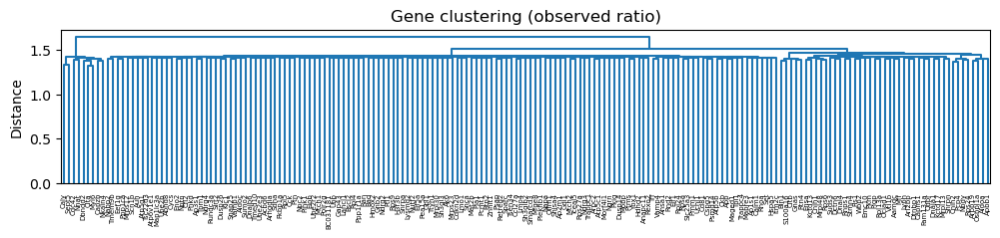

In [52]:
# Example distance matrix
dist_matrix = 1 - rvcoef_ratio

# Perform hierarchical clustering
linked = linkage(dist_matrix, 'ward')

# Plot the dendrogram
plt.figure(figsize=(12, 2))
dendrogram(linked, orientation='top', labels=gene_name_list)
plt.title('Gene clustering (observed ratio)')
plt.xlabel('')
plt.ylabel('Distance')
plt.show()

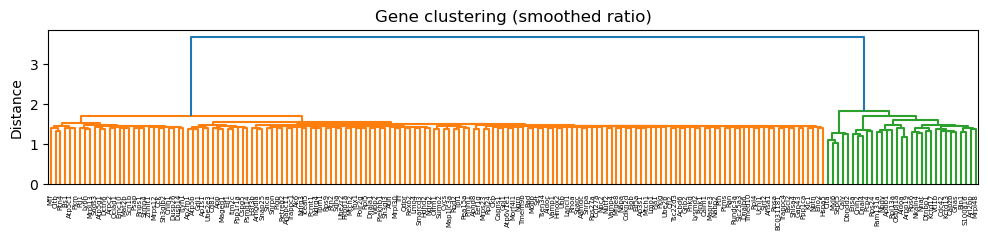

In [53]:
# Example distance matrix
dist_matrix = 1 - rvcoef_ratio_smoothed

# Perform hierarchical clustering
linked = linkage(dist_matrix, 'ward')

# Plot the dendrogram
plt.figure(figsize=(12, 2))
dendrogram(linked, orientation='top', labels=gene_name_list)
plt.title('Gene clustering (smoothed ratio)')
plt.xlabel('')
plt.ylabel('Distance')
plt.show()

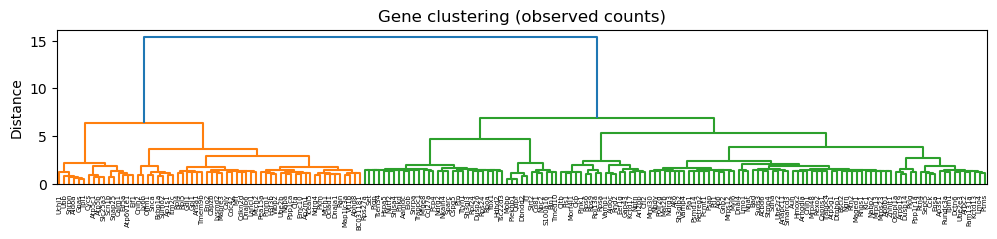

In [54]:
# Example distance matrix
dist_matrix = 1 - RVcoeff(counts_list)

# Perform hierarchical clustering
linked = linkage(dist_matrix, 'ward')

# Plot the dendrogram
plt.figure(figsize=(12, 2))
dendrogram(linked, orientation='top', labels=gene_name_list)
plt.title('Gene clustering (observed counts)')
plt.xlabel('')
plt.ylabel('Distance')
plt.show()

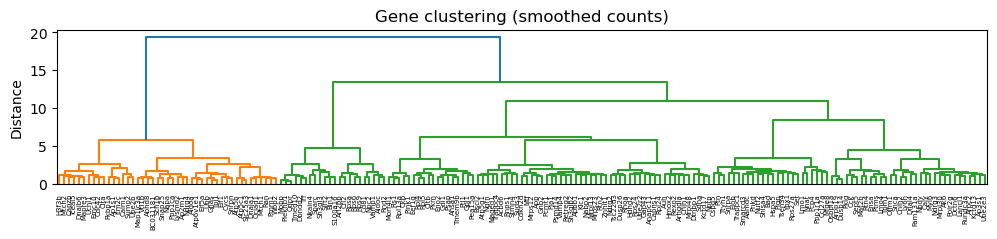

In [55]:
# Example distance matrix
dist_matrix = 1 - RVcoeff(counts_smoothed_list)

# Perform hierarchical clustering
linked = linkage(dist_matrix, 'ward')

# Plot the dendrogram
plt.figure(figsize=(12, 2))
dendrogram(linked, orientation='top', labels=gene_name_list)
plt.title('Gene clustering (smoothed counts)')
plt.xlabel('')
plt.ylabel('Distance')
plt.show()

#### MDS distance embedding

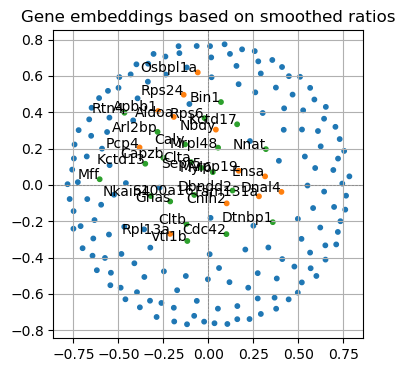

In [60]:
# distance_matrix = 1 - RVcoeff(counts_list)
distance_matrix = 1 - RVcoeff(ratios_smoothed_list)
# distance_matrix = 1 - RVcoeff(counts_smoothed_list)

# Number of dimensions to embed into (2D)
n_components = 2

# Perform MDS
mds = MDS(n_components=n_components, dissimilarity='precomputed', random_state=42)
embedded_coords = mds.fit_transform(distance_matrix)

# Perform hierarchical clustering
# 'linkage' computes the hierarchical clustering tree
linkage_matrix = linkage(distance_matrix[np.triu_indices(len(distance_matrix), 1)], method='ward')

# Extract cluster labels
# Use fcluster to assign cluster labels based on a distance threshold or number of clusters
num_clusters = 3  # Set the desired number of clusters
cluster_labels = fcluster(linkage_matrix, num_clusters, criterion='maxclust')

# Map cluster labels to colors
colors = plt.cm.tab10(cluster_labels - 1)  # Use a colormap (e.g., tab10) for 

# Extract x and y coordinates
x_coords = embedded_coords[:, 0]
y_coords = embedded_coords[:, 1]

# Visualize the results
plt.figure(figsize=(4, 4))
scatter = plt.scatter(
    embedded_coords[:, 0], 
    embedded_coords[:, 1], 
    c=colors, 
    # cmap='tab10', 
    s=10, 
)

# Annotate points for clarity
for i, (x, y) in enumerate(zip(x_coords, y_coords)):
    if cluster_labels[i] in [2, 3]:
        plt.text(x, y, f'{gene_name_list[i]}', fontsize=10, ha='right')

plt.title('Gene embeddings based on smoothed ratios')
plt.xlabel('')
plt.ylabel('')
plt.axhline(0, color='gray', linestyle='--', linewidth=0.5)
plt.axvline(0, color='gray', linestyle='--', linewidth=0.5)
plt.grid(True)
plt.show()

#### Visualize archetypes

In [63]:
df_gene_cluster = pd.DataFrame({
    'gene': gene_name_list,
    'clu': cluster_labels
})

# extract top5 SVS genes per cluster 
_df = pd.merge(df_gene_cluster, df_sv_cbs.reset_index(), on = 'gene', how='left')
_df = _df.groupby('clu').apply(lambda x: x.nsmallest(5,['pvalue_hsic-ir_2'])).reset_index(drop=True)
_df

/var/folders/_f/m4v2g8c54gdfks59bp2f2cm80000gn/T/ipykernel_65340/1028257231.py:8: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.


,gene,clu,n_iso_1,pct_spot_on_1,count_avg_1,count_std_1,perplexity_1,major_ratio_avg_1,pvalue_hsic-ir_1,padj_hsic-ir_1,...,pvalue_hsic-gc_2,padj_hsic-gc_2,pvalue_spark-x_2,padj_spark-x_2,is_ont_svs_2,is_ont_sve_2,is_ont_expressed_2,is_ont_svs,is_ont_sve,is_ont_expressed
0,Snap25,1,2.0,0.725781,3.057812,3.817182,1.475349,0.868677,2.327619e-39,3.213484e-37,...,3.172220e-159,9.860637e-158,5.784938e-67,1.428076e-64,True,True,True,True,True,True
1,App,1,2.0,0.662109,1.457812,1.634760,1.388050,0.898714,9.090521e-03,7.990806e-02,...,7.057832e-63,4.215094e-62,1.904928e-20,6.475868e-19,True,True,True,False,True,True
2,Cnih1,1,3.0,0.519922,0.939844,1.234709,2.173463,0.707398,1.544563e-06,4.119419e-05,...,2.926979e-47,1.233922e-46,1.005168e-20,3.476862e-19,True,True,True,True,True,True
3,Mrpl13,1,2.0,0.564063,1.041797,1.247893,1.674323,0.788901,1.648412e-12,8.597387e-11,...,1.001943e-44,3.976943e-44,6.615509e-24,2.767957e-22,True,True,True,True,True,True
4,Ly6h,1,5.0,0.835938,5.082031,6.158796,2.419032,0.621599,2.124956e-29,2.624880e-27,...,8.013157e-155,2.349312e-153,3.469019e-49,4.492590e-47,True,True,True,True,True,True
5,Arpp19,2,5.0,0.540625,1.316406,1.852965,3.255794,0.551632,1.484379e-151,1.741919e-148,...,8.156317e-227,6.788160e-225,9.628107e-80,3.550490e-77,True,True,True,True,True,True
6,Cnih2,2,2.0,0.858203,6.683984,8.552854,1.135266,0.972240,1.328552e-61,2.598427e-59,...,3.883810e-169,1.372634e-167,2.256219e-48,2.887565e-46,True,True,True,True,True,True
7,Pcp4,2,2.0,0.670312,2.678125,3.882894,1.159898,0.966015,8.594001e-50,1.551548e-47,...,1.728152e-115,2.718678e-114,2.215089e-19,7.035582e-18,True,True,True,True,True,True
8,Nbdy,2,3.0,0.646484,1.392578,1.565554,1.993234,0.673212,2.568066e-81,8.610360e-79,...,1.453799e-54,7.144386e-54,2.423643e-27,1.229167e-25,True,True,True,True,True,True
9,Rps24,2,5.0,0.941406,3.774609,2.530976,2.009074,0.773466,1.445283e-65,3.083707e-63,...,3.896582e-126,7.030197e-125,6.632688e-72,1.924100e-69,True,True,True,True,True,True


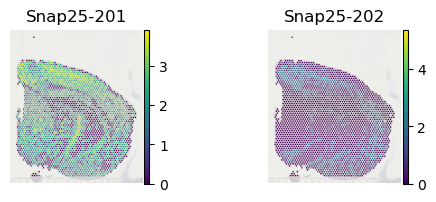

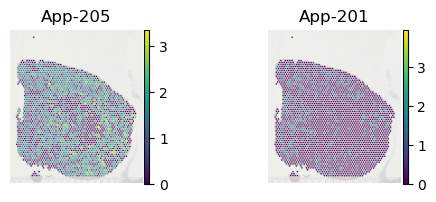

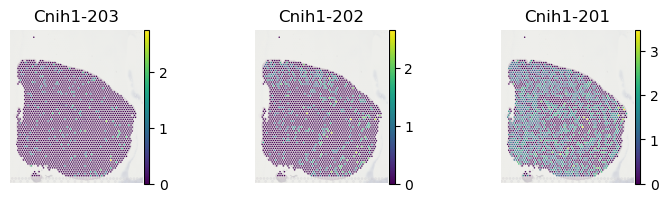

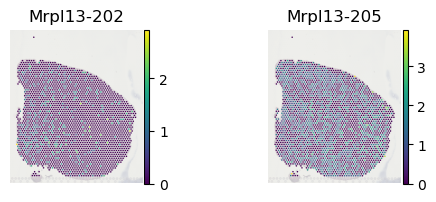

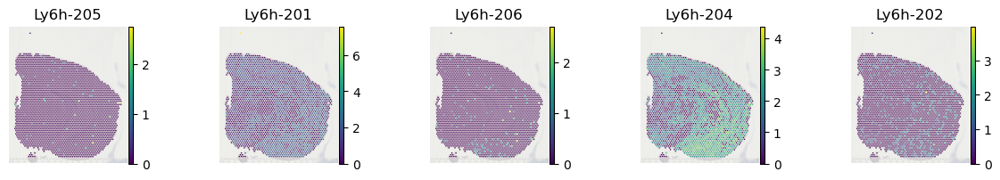

In [64]:
_svs_to_plot = _df['gene'][:5].to_list()
with plt.rc_context({"figure.figsize": (2, 2)}):
    for _gene in _svs_to_plot:
        _iso_to_plot = adata_ont_sv.var.index[adata_ont_sv.var['gene_symbol'] == _gene]
        _name_to_plot = adata_ont_sv.var.loc[adata_ont_sv.var['gene_symbol'] == _gene, 'transcript_name']
        sc.pl.spatial(
            adata_ont_sv, color = _iso_to_plot, title = _name_to_plot,
            img_key = 'lowres', alpha_img = 0.3, 
            layer = 'log1p', ncols = len(_iso_to_plot),
            frameon=False
        )

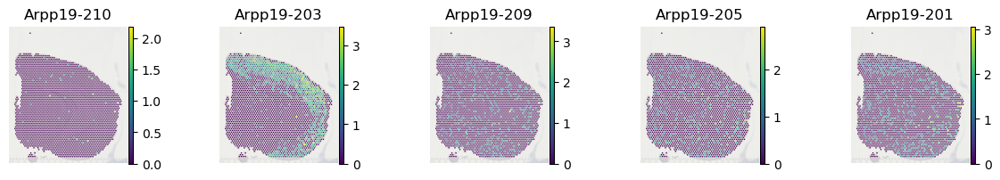

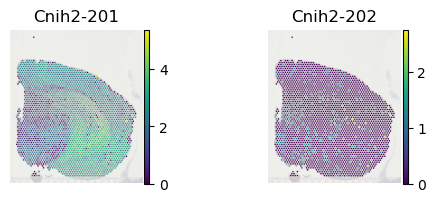

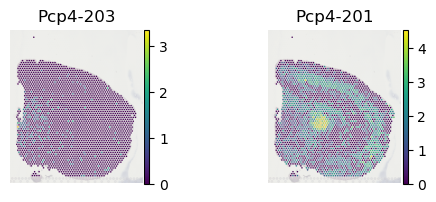

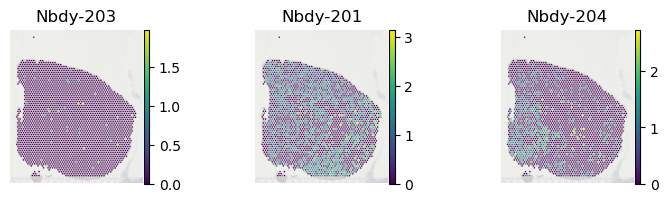

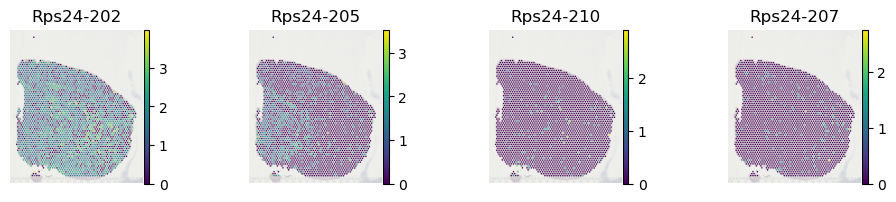

In [65]:
_svs_to_plot = _df['gene'][5:10].to_list()
with plt.rc_context({"figure.figsize": (2, 2)}):
    for _gene in _svs_to_plot:
        _iso_to_plot = adata_ont_sv.var.index[adata_ont_sv.var['gene_symbol'] == _gene]
        _name_to_plot = adata_ont_sv.var.loc[adata_ont_sv.var['gene_symbol'] == _gene, 'transcript_name']
        sc.pl.spatial(
            adata_ont_sv, color = _iso_to_plot, title = _name_to_plot,
            img_key = 'lowres', alpha_img = 0.3, 
            layer = 'log1p', ncols = len(_iso_to_plot),
            frameon=False
        )

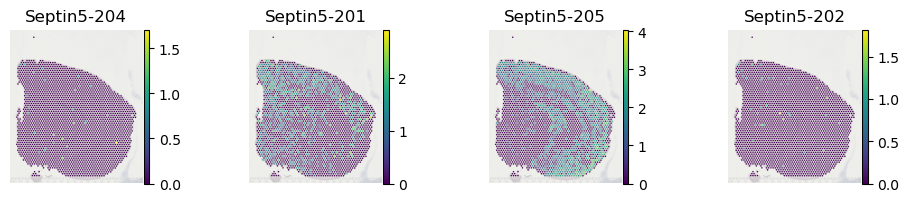

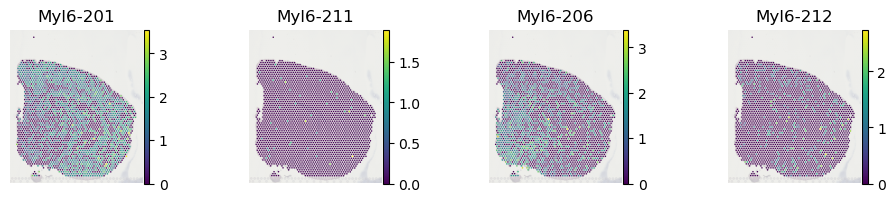

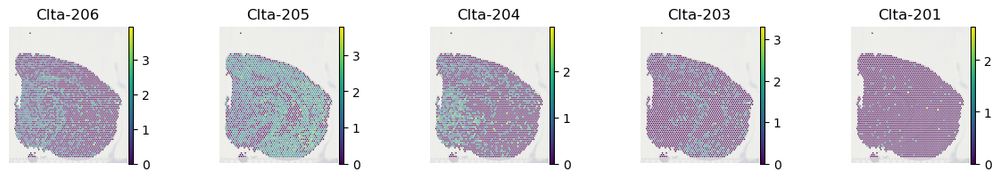

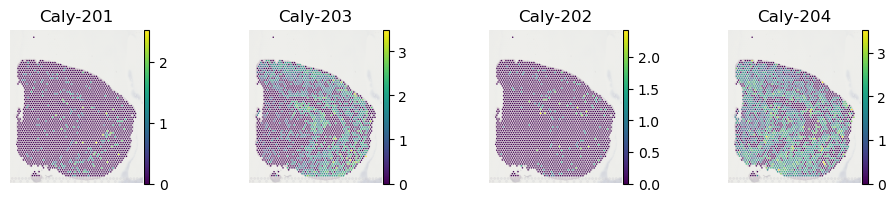

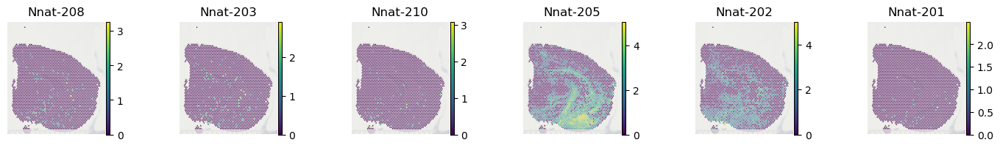

In [66]:
_svs_to_plot = _df['gene'][10:].to_list()
with plt.rc_context({"figure.figsize": (2, 2)}):
    for _gene in _svs_to_plot:
        _iso_to_plot = adata_ont_sv.var.index[adata_ont_sv.var['gene_symbol'] == _gene]
        _name_to_plot = adata_ont_sv.var.loc[adata_ont_sv.var['gene_symbol'] == _gene, 'transcript_name']
        sc.pl.spatial(
            adata_ont_sv, color = _iso_to_plot, title = _name_to_plot,
            img_key = 'lowres', alpha_img = 0.3, 
            layer = 'log1p', ncols = len(_iso_to_plot),
            frameon=False
        )

#### Save RV coeffients and example genes

In [67]:
res_dir = "/Users/jysumac/Projects/SPLISOSM_paper/results/sit_nar_23/"

import os
if not os.path.exists(f"{res_dir}/figures/cbs/source_data/"):
    os.makedirs(f"{res_dir}/figures/cbs/source_data/")

In [68]:
# extract smoothed ratios
_, ratios_smoothed_list, gene_name_list, _ = extract_counts_n_ratios(
    adata_ont_sv, layer = 'counts_smoothed', group_iso_by = 'gene_symbol'
)

# convert RV coef matrix to dataframe
rvcoef = RVcoeff(ratios_smoothed_list)
print(rvcoef.shape)

df = pd.DataFrame(rvcoef, index=gene_name_list, columns=gene_name_list)

# Save the correlation matrix to a CSV file
df.to_csv(f"{res_dir}/figures/cbs/source_data/rvcoeff.csv", index = True)

(189, 189)


In [69]:
# save isoform usage per spot
_svs_to_save = ["Snap25", "App", "Cnih1", "Mrpl13", "Ly6h", 
                "Arpp19", "Cnih2", "Pcp4", "Nbdy", "Rps24", 
                "Sept5", "Myl6", "Clta", "Caly", "Nnat"]

df_svs_ratio = []
for _layer in ['log1p', 'ratios_smoothed']:
    df_layer = []
    # loop over SVS genes
    for _svs in _svs_to_save:
        df_svs = adata_ont_sv.obs[['array_row', 'array_col']].reset_index(names = 'barcode')
        _iso_list = adata_ont_sv.var_names[adata_ont_sv.var['gene_symbol'] == _svs]
        for _iso in _iso_list:
            df_svs[_iso] = adata_ont_sv[df_svs['barcode'], _iso].layers[_layer].toarray().squeeze()
        df_svs = df_svs.melt(id_vars=['barcode', 'array_row', 'array_col'], 
                             var_name='isoform', value_name='value')
        df_svs = pd.merge(
            df_svs, adata_ont_sv.var[['transcript_id', 'transcript_name']],
            how = 'left', left_on=['isoform'], right_index=True
        )
        df_svs['gene'] = _svs
        df_layer.append(df_svs)

    # concatenate all genes
    df_layer = pd.concat(df_layer, axis = 0)
    df_layer['layer'] = _layer
    df_svs_ratio.append(df_layer)

df_svs_ratio = pd.concat(df_svs_ratio, axis = 0)
df_svs_ratio.to_csv(f"{res_dir}/figures/cbs/source_data/gene_program_top5_ratio.csv", index = False)

### Clustering RBP genes

#### Compute and visualize RBP coexpression

/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


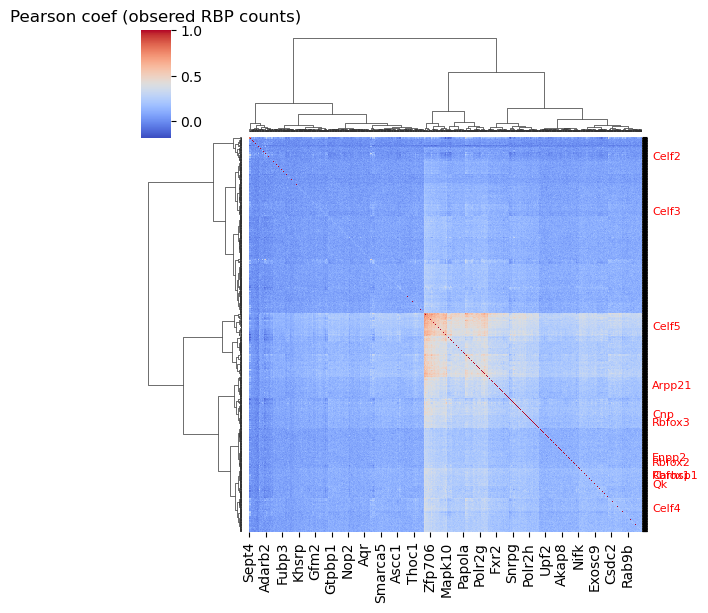

In [70]:
rbp_name_list = adata_visium_rbp.var_names[adata_visium_rbp.var['is_visium_sve']].to_list()
rbp_counts = adata_visium_rbp[:, adata_visium_rbp.var['is_visium_sve']].layers['counts'].toarray()
rbp_corr = np.corrcoef(rbp_counts, rowvar=False)

df_cor = pd.DataFrame(rbp_corr, index=rbp_name_list, columns=rbp_name_list)

# Create a heatmap for the correlation matrix
clustermap = sns.clustermap(
    df_cor,
    method="ward",  # Hierarchical clustering method
    metric="euclidean",  # Distance metric
    cmap="coolwarm",  # Color map
    annot=False,  # Annotate with correlation values
    # vmin=0, vmax=0.5,
    figsize=(6, 6)
)

highlight_genes = ['Rbfox3', 'Rbfox2', 'Rbfox1', 'Qk',
                   'Celf2', 'Celf3', 'Celf4', 'Celf5',
                   'Cnp', 'Enpp2', 'Carhsp1', 'Arpp21']

# Hide all row and column labels except for the selected genes
ax = clustermap.ax_heatmap  # Access the heatmap axis
ax.set_yticks(range(len(df_cor.index)))  # Set ticks for all Y-axis labels
ax.set_yticklabels(df_cor.index, fontsize=8)  # Set all Y-axis tick labels

# Loop through labels to hide non-highlighted ones
for tick_label in ax.get_yticklabels():
    if tick_label.get_text() not in highlight_genes:
        tick_label.set_visible(False)  # Hide all labels except highlighted genes
    else:
        tick_label.set_color("red")  # Highlight specific genes in red

# Add title and axis labels
plt.title("Pearson coef (obsered RBP counts)", fontsize=12)
plt.show()

### Anndata I/O

#### Save the ONT SVS anndata with cluster and GLMM results

In [71]:
res_dir = "/Users/jysumac/Projects/SPLISOSM_paper/results/sit_nar_23/"
date = '1107'

adata_ont_sv.write_h5ad(f"{res_dir}/anndata/cbs2_svs_clu_{date}.h5ad")

#### Load precomputed ONT SVS anndata with cluster and GLMM results

In [72]:
res_dir = "/Users/jysumac/Projects/SPLISOSM_paper/results/sit_nar_23/"
date = '1107'

adata_ont_sv = sc.read_h5ad(f"{res_dir}/anndata/cbs2_svs_clu_{date}.h5ad")

### Visualize isoform usage of selected genes

#### Compared with the original differential usage gene list

In [73]:
data_dir = "/Users/jysumac/Projects/SPLISOSM_paper/data/sit_nar_23/"
_markers = pd.read_table(f"{data_dir}/supp_files/cbs_marker_gene.txt", header = 0)
sit_markers = pd.DataFrame({
    'gene': pd.concat([_markers['CBS1'], _markers['CBS2']]).drop_duplicates()
})
sit_markers['CBS1'] = sit_markers['gene'].isin(_markers['CBS1'].drop_duplicates())
sit_markers['CBS2'] = sit_markers['gene'].isin(_markers['CBS2'].drop_duplicates())
sit_markers['is_ont_svs'] = sit_markers['gene'].isin(df_sv_cbs['is_ont_svs'].index)

In [74]:
# all previously reported genes are spatially variably spliced 
sit_markers.groupby(['is_ont_svs', 'CBS1', 'CBS2']).size()

is_ont_svs  CBS1   CBS2 
False       False  True       4
            True   False      1
True        False  True     101
            True   False     65
                   True      61
dtype: int64

#### Genes not significant in at least one sample in Lebrigrand et al. 

In [75]:
# SVS genes not sig in at least one samples
df_novel_svs_cbs = df_sv_cbs.loc[
    df_sv_cbs['is_ont_svs'] & df_sv_cbs['is_ont_expressed'] & 
   (~df_sv_cbs.index.isin(
       sit_markers.loc[(sit_markers['CBS1'] & sit_markers['CBS1']), 'gene'])
   )
]
df_novel_svs_cbs.head()

,n_iso_1,pct_spot_on_1,count_avg_1,count_std_1,perplexity_1,major_ratio_avg_1,pvalue_hsic-ir_1,padj_hsic-ir_1,pvalue_hsic-ic_1,padj_hsic-ic_1,...,pvalue_hsic-gc_2,padj_hsic-gc_2,pvalue_spark-x_2,padj_spark-x_2,is_ont_svs_2,is_ont_sve_2,is_ont_expressed_2,is_ont_svs,is_ont_sve,is_ont_expressed
gene,,,,,,,,,,,,,,,,,,,,,
Arpp19,5,0.540625,1.316406,1.852965,3.255794,0.551632,1.484379e-151,1.741919e-148,7.198302e-243,2.815736e-240,...,8.156317e-227,6.788160e-225,9.628107e-80,3.550490e-77,True,True,True,True,True,True
Nnat,6,0.659766,5.437109,12.644074,1.863624,0.805374,1.856826e-68,4.357970e-66,2.806468e-271,1.646695e-268,...,1.641361e-225,1.283246e-223,1.050409e-64,2.240566e-62,True,True,True,True,True,True
Cnih2,2,0.858203,6.683984,8.552854,1.135266,0.972240,1.328552e-61,2.598427e-59,1.426517e-255,6.696071e-253,...,3.883810e-169,1.372634e-167,2.256219e-48,2.887565e-46,True,True,True,True,True,True
Aldoa,2,0.926562,8.861328,10.924631,1.306771,0.924532,1.126961e-47,1.889270e-45,5.000836e-114,1.235470e-112,...,2.026643e-81,1.784553e-80,2.863024e-25,1.276453e-23,True,True,True,True,True,True
Ly6h,5,0.835938,5.082031,6.158796,2.419032,0.621599,2.124956e-29,2.624880e-27,3.259252e-298,3.824733e-295,...,8.013157e-155,2.349312e-153,3.469019e-49,4.492590e-47,True,True,True,True,True,True


In [76]:
df_novel_svs_cbs.loc[:, ['pvalue_hsic-ir_1', 'pvalue_hsic-ir_2']].head()

,pvalue_hsic-ir_1,pvalue_hsic-ir_2
gene,,
Arpp19,1.484379e-151,5.420005e-244
Nnat,1.856826e-68,3.214921e-92
Cnih2,1.328552e-61,1.712938e-104
Aldoa,1.126961e-47,1.464922e-57
Ly6h,2.124956e-29,1.315945e-21


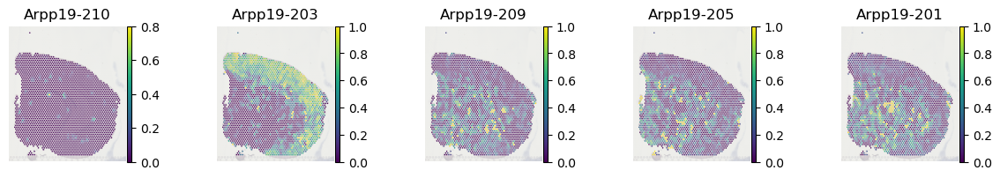

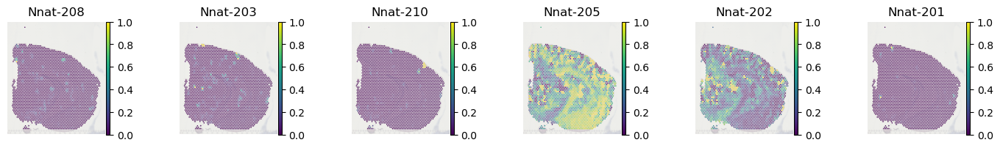

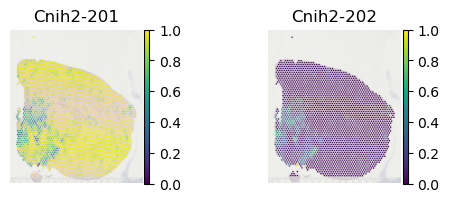

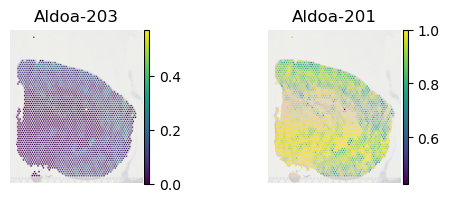

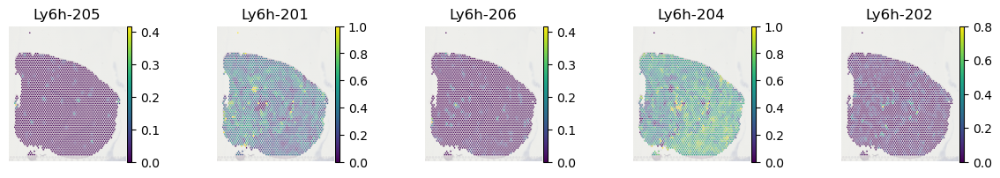

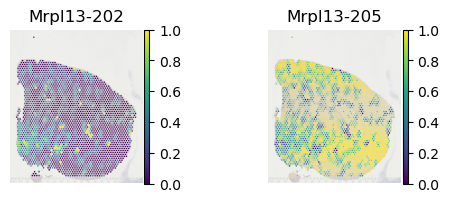

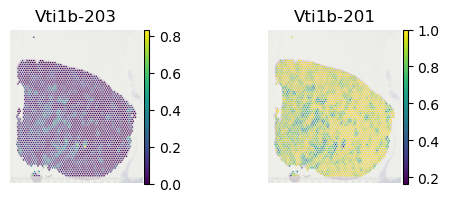

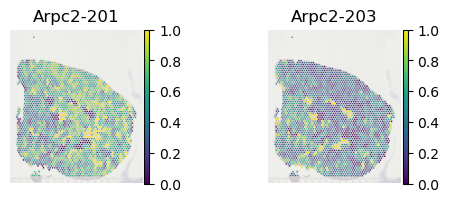

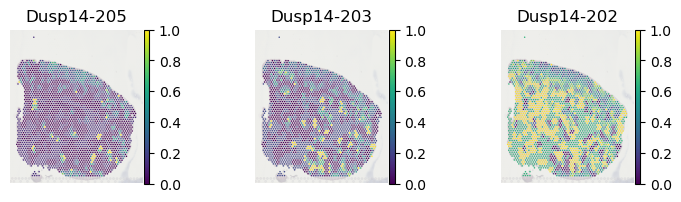

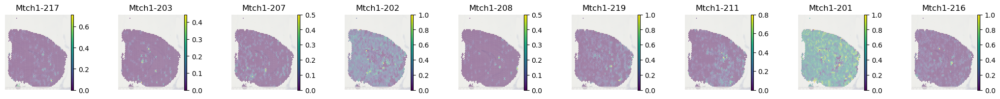

In [77]:
_svs_to_plot = df_novel_svs_cbs.head(10).index.to_list()
with plt.rc_context({"figure.figsize": (2, 2)}):
    for _gene in _svs_to_plot:
        _iso_to_plot = adata_ont_sv.var.index[adata_ont_sv.var['gene_symbol'] == _gene]
        _name_to_plot = adata_ont_sv.var.loc[adata_ont_sv.var['gene_symbol'] == _gene, 'transcript_name']
        sc.pl.spatial(
            adata_ont_sv, color = _iso_to_plot, title=_name_to_plot,
            img_key = 'lowres', alpha_img = 0.3, 
            layer = 'ratios_smoothed', ncols = len(_iso_to_plot),
            frameon=False
        )

#### Novel SVS genes not reported

In [78]:
# SVS genes not reported in the original paper
df_novel_svs_cbs = df_sv_cbs.loc[
    df_sv_cbs['is_ont_svs'] & df_sv_cbs['is_ont_expressed'] & 
   (~df_sv_cbs.index.isin(sit_markers['gene']))
]
df_novel_svs_cbs.head()

,n_iso_1,pct_spot_on_1,count_avg_1,count_std_1,perplexity_1,major_ratio_avg_1,pvalue_hsic-ir_1,padj_hsic-ir_1,pvalue_hsic-ic_1,padj_hsic-ic_1,...,pvalue_hsic-gc_2,padj_hsic-gc_2,pvalue_spark-x_2,padj_spark-x_2,is_ont_svs_2,is_ont_sve_2,is_ont_expressed_2,is_ont_svs,is_ont_sve,is_ont_expressed
gene,,,,,,,,,,,,,,,,,,,,,
Arpc2,2,0.555078,1.239062,1.768617,1.872168,0.679697,6.329755e-11,2.971187e-09,5.165704e-106,1.027450e-104,...,2.905988e-61,1.700102e-60,2.826464e-16,7.554723e-15,True,True,True,True,True,True
Dusp14,3,0.298828,0.520312,1.027539,2.753633,0.534535,1.024320e-10,4.623228e-09,4.381478e-140,2.056666e-138,...,3.022879e-195,1.529221e-193,3.533919e-77,1.164963e-74,True,True,True,True,True,True
Mtch1,9,0.816797,3.196875,3.493564,4.261949,0.535068,1.066136e-10,4.721173e-09,1.519880e-78,1.557711e-77,...,6.265670e-61,3.632681e-60,7.008723e-20,2.293067e-18,True,True,True,True,True,True
Pigp,4,0.470703,0.715234,0.943606,3.048402,0.462043,6.641313e-09,2.555272e-07,6.783908e-48,3.380431e-47,...,5.661363e-29,1.544008e-28,6.661338e-16,1.711108e-14,True,True,True,True,True,True
Fam131a,3,0.293750,0.536328,1.084086,2.163988,0.662782,4.356585e-08,1.597641e-06,1.983627e-88,2.630267e-87,...,1.475856e-64,9.044439e-64,1.687969e-20,5.774399e-19,True,True,True,True,True,True


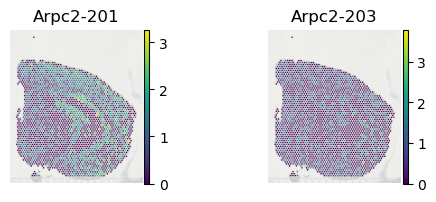

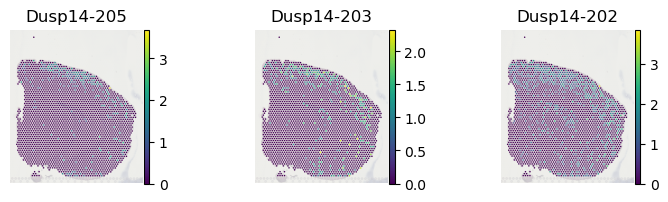

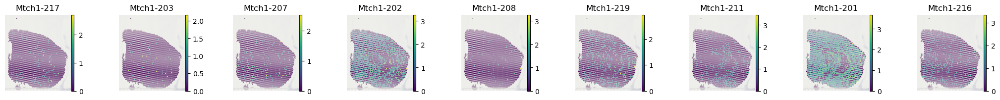

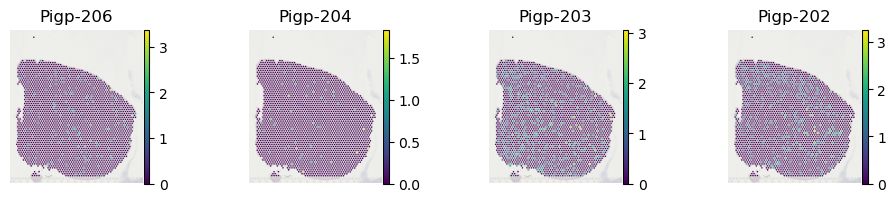

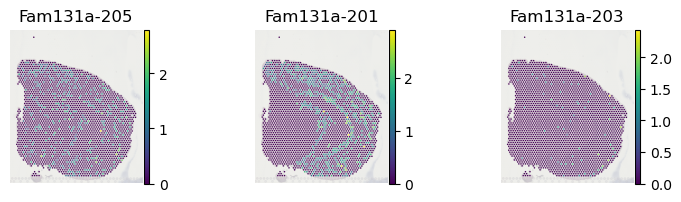

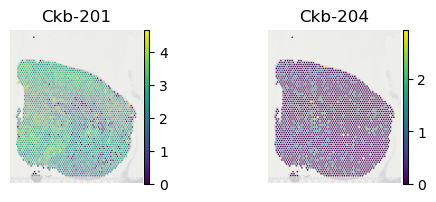

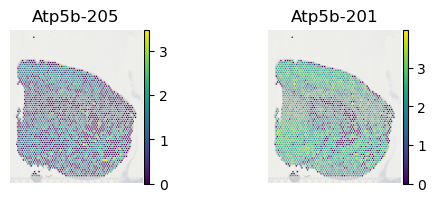

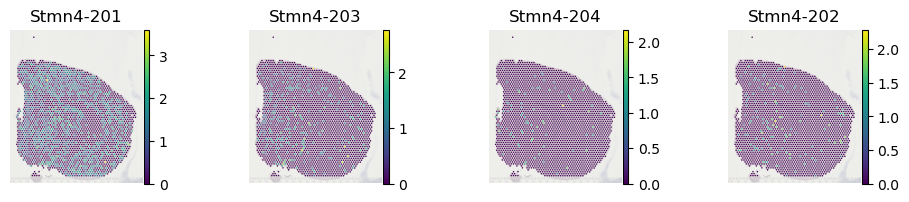

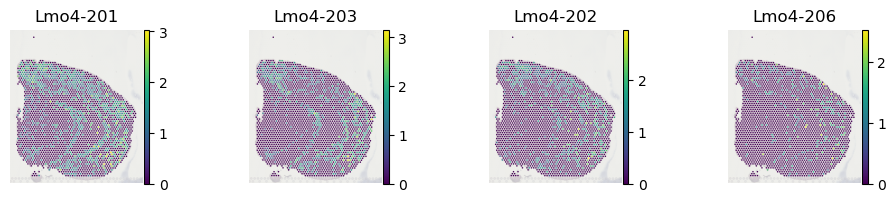

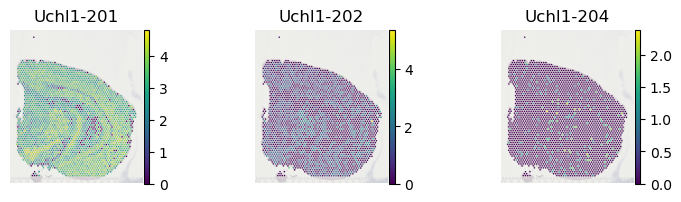

In [79]:
_svs_to_plot = df_novel_svs_cbs.head(10).index.to_list()
with plt.rc_context({"figure.figsize": (2, 2)}):
    for _gene in _svs_to_plot:
        _iso_to_plot = adata_ont_sv.var.index[adata_ont_sv.var['gene_symbol'] == _gene]
        _name_to_plot = adata_ont_sv.var.loc[adata_ont_sv.var['gene_symbol'] == _gene, 'transcript_name']
        sc.pl.spatial(
            adata_ont_sv, color = _iso_to_plot, title=_name_to_plot,
            img_key = 'lowres', alpha_img = 0.3, 
            layer = 'log1p', ncols = len(_iso_to_plot),
            frameon=False
        )

## Differential usage (DU) tests with RBP expression

### Load DU test results

In [55]:
# merge parametric and non-parametric test results
def load_du_tests(sample_id):
    df_du_hsic = pd.read_csv(f"{res_dir}/du_np_results/{sample_id}_rbp_du_np_combined_{date}.csv", index_col=[0,1])
    df_du_glmm = pd.read_csv(f"{res_dir}/du_p_results/{sample_id}_rbp_du_p_combined_{date}.csv", index_col=[0,1])
    df_du_rbp = df_du_hsic.join(df_du_glmm)
    return df_du_rbp

# load DU results for the two replicates
df_du_cbs1 = load_du_tests('cbs1')
df_du_cbs2 = load_du_tests('cbs2')

# define significant events
for _df in [df_du_cbs1, df_du_cbs2]:
    _df['is_significant'] = (_df['pvalue_hsic-gp'] < 0.01) & (_df['pvalue_glmm'] < 0.01)

# merge two cbs samples into one df
# all of the remaining target genes are SVS in both samples
df_du_cbs = pd.merge(
    df_du_cbs1, df_du_cbs2, 
    how='inner', left_index=True, right_index=True, 
    suffixes=['_1', '_2']
).reset_index()

# keep significant genes in both samples
df_du_cbs['is_significant'] = df_du_cbs['is_significant_1'] & df_du_cbs['is_significant_2']

In [56]:
# check general statistics
print(f"Number of SVS genes: {df_du_cbs['gene'].nunique()}; Number of RBPs: {df_du_cbs['covariate'].nunique()}.")
print(f"Number of significant associations: {df_du_cbs['is_significant'].sum()}.")
print(f"Number of SVS genes with sig associations: {df_du_cbs.loc[df_du_cbs['is_significant'], 'gene'].nunique()}.")
print(f"Number of RBPs with sig associations: {df_du_cbs.loc[df_du_cbs['is_significant'], 'covariate'].nunique()}.")

Number of SVS genes: 92; Number of RBPs: 965.
Number of significant associations: 746.
Number of SVS genes with sig associations: 39.
Number of RBPs with sig associations: 227.


### Comparison between two replicates

#### DU results, CBS1 vs CBS2

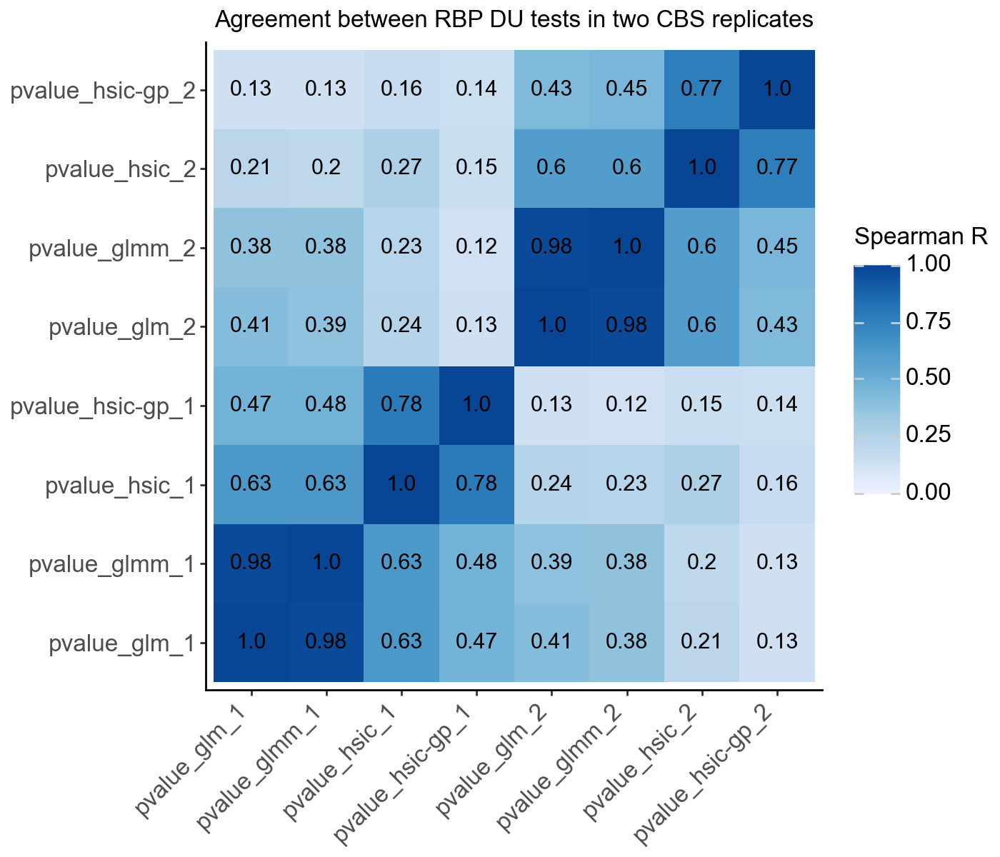

In [57]:
_cols_to_compare = [f"{_col}_{_s}" 
    for _s in ['1', '2']
    for _col in ['pvalue_glm', 'pvalue_glmm', 'pvalue_hsic', 'pvalue_hsic-gp']
]

# all of the tested genes are SVS in both samples
_df = df_du_cbs.set_index(['gene', 'covariate']).loc[:, _cols_to_compare]

_conf_mat = pd.DataFrame(
    spearmanr(_df)[0], 
    columns = _df.columns, 
    index = _df.columns
).reset_index(names='id')
_conf_mat = pd.melt(_conf_mat, id_vars='id').round(2)

_conf_mat['id'] = pd.Categorical(_conf_mat['id'], ordered=True, categories=_cols_to_compare)
_conf_mat['variable'] = pd.Categorical(_conf_mat['variable'], ordered=True, categories=_cols_to_compare)

(
    ggplot(_conf_mat, aes(x = 'id', y = 'variable', fill = 'value')) + 
        geom_tile() + 
        geom_text(aes(label = 'value')) + 
        scale_fill_distiller(limits = (0, 1), direction = 1) + 
        labs(x = '', y = '', fill = 'Spearman R', title = 'Agreement between RBP DU tests in two CBS replicates') + 
        theme_classic() + 
        theme(
            figure_size = [7, 6],
            text = element_text(size = 12, family='Arial'), 
            axis_text = element_text(size = 12, family='Arial'), 
            axis_text_x = element_text(rotation=45, hjust = 1, vjust = 1)
        )
)

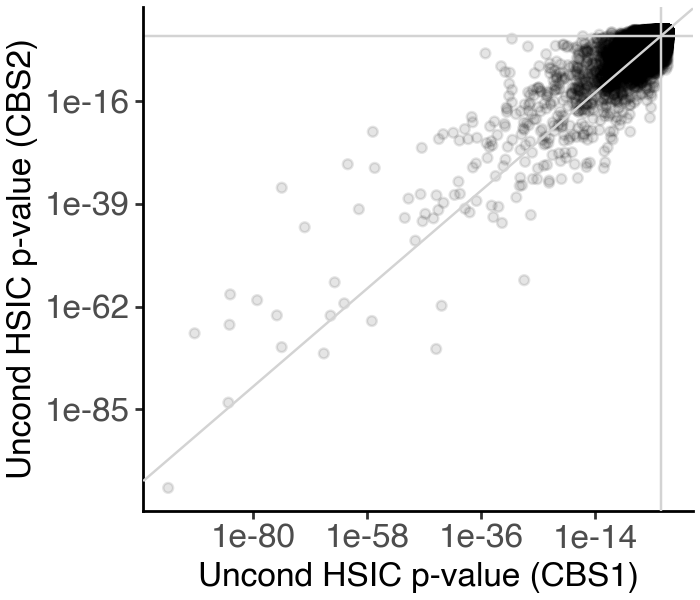

In [58]:
_df = df_du_cbs
(
    ggplot(_df, aes(x = 'pvalue_hsic_1', y = 'pvalue_hsic_2')) +
        # stat_density_2d(levels = 5) + 
        geom_point(alpha = 0.1) + 
        geom_hline(yintercept = 0.05, color = 'lightgray') + 
        geom_vline(xintercept = 0.05, color = 'lightgray') + 
        geom_abline(slope = 1, color = 'lightgray') + 
        labs(x = 'Uncond HSIC p-value (CBS1)', y = 'Uncond HSIC p-value (CBS2)') + 
        scale_x_log10() + 
        scale_y_log10() + 
        theme_classic() + 
        theme(figure_size=[3.5,3],
             text=element_text(size = 12))
)

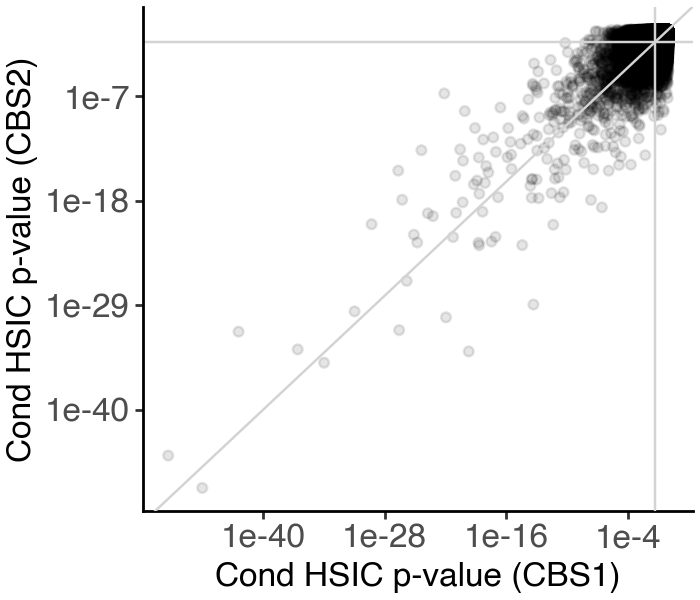

In [59]:
_df = df_du_cbs
(
    ggplot(_df, aes(x = 'pvalue_hsic-gp_1', y = 'pvalue_hsic-gp_2')) +
        # stat_density_2d(levels = 5) + 
        geom_point(alpha = 0.1) + 
        geom_hline(yintercept = 0.05, color = 'lightgray') + 
        geom_vline(xintercept = 0.05, color = 'lightgray') + 
        geom_abline(slope = 1, color = 'lightgray') + 
        labs(x = 'Cond HSIC p-value (CBS1)', y = 'Cond HSIC p-value (CBS2)') + 
        scale_x_log10() + 
        scale_y_log10() + 
        theme_classic() + 
        theme(figure_size=[3.5,3],
             text=element_text(size = 12))
)

/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10


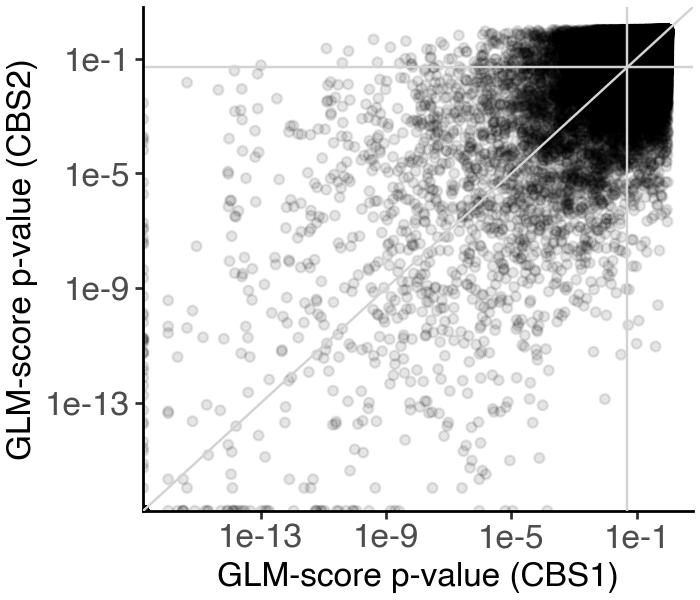

In [60]:
_df = df_du_cbs
(
    ggplot(_df, aes(x = 'pvalue_glm_1', y = 'pvalue_glm_2')) +
        # stat_density_2d(levels = 5) + 
        geom_point(alpha = 0.1) + 
        geom_hline(yintercept = 0.05, color = 'lightgray') + 
        geom_vline(xintercept = 0.05, color = 'lightgray') + 
        geom_abline(slope = 1, color = 'lightgray') + 
        labs(x = 'GLM-score p-value (CBS1)', y = 'GLM-score p-value (CBS2)') + 
        scale_x_log10() + 
        scale_y_log10() + 
        theme_classic() + 
        theme(figure_size=[3.5,3],
             text=element_text(size = 12))
)

/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10


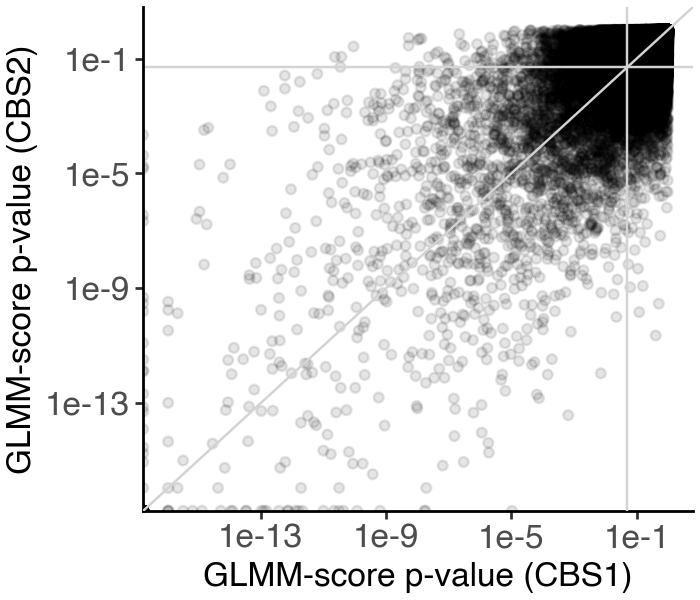

In [61]:
_df = df_du_cbs
(
    ggplot(_df, aes(x = 'pvalue_glmm_1', y = 'pvalue_glmm_2')) +
        # stat_density_2d(levels = 5) + 
        geom_point(alpha = 0.1) + 
        geom_hline(yintercept = 0.05, color = 'lightgray') + 
        geom_vline(xintercept = 0.05, color = 'lightgray') + 
        geom_abline(slope = 1, color = 'lightgray') + 
        labs(x = 'GLMM-score p-value (CBS1)', y = 'GLMM-score p-value (CBS2)') + 
        scale_x_log10() + 
        scale_y_log10() + 
        theme_classic() + 
        theme(figure_size=[3.5,3],
             text=element_text(size = 12))
)

#### DU results, CBS2

/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10


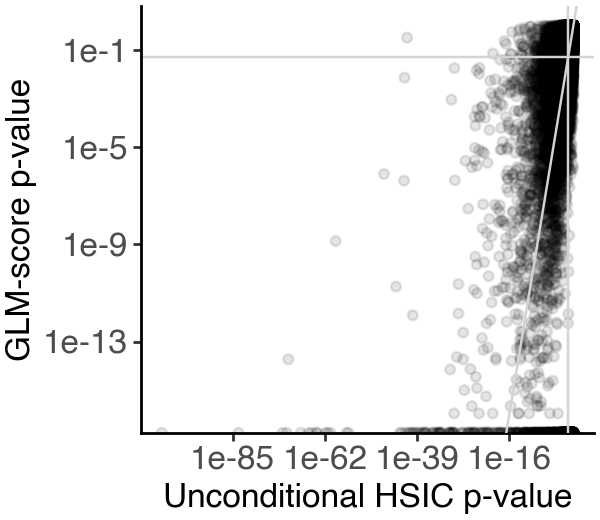

In [62]:
_df = df_du_cbs
(
    ggplot(_df, aes(x = 'pvalue_hsic_2', y = 'pvalue_glm_2')) +
        # stat_density_2d(levels = 5) + 
        geom_point(alpha = 0.1) + 
        geom_hline(yintercept = 0.05, color = 'lightgray') + 
        geom_vline(xintercept = 0.05, color = 'lightgray') + 
        geom_abline(slope = 1, color = 'lightgray') + 
        labs(x = 'Unconditional HSIC p-value', y = 'GLM-score p-value') + 
        scale_x_log10() + 
        scale_y_log10() + 
        theme_classic() + 
        theme(figure_size=[3,2.6],
             text=element_text(size = 12))
)

/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10


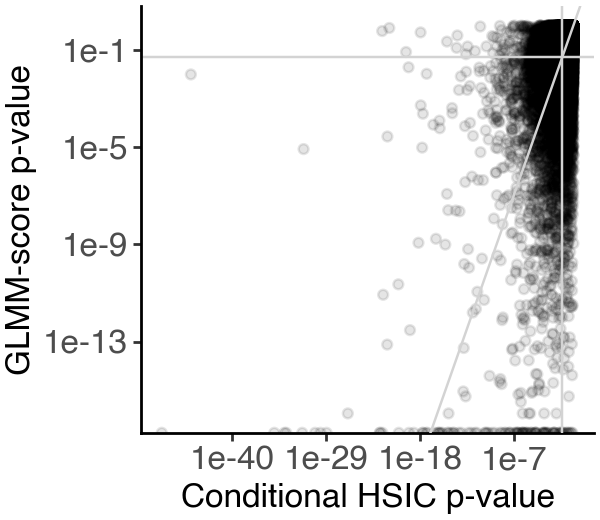

In [63]:
_df = df_du_cbs
(
    ggplot(_df, aes(y = 'pvalue_glmm_2', x = 'pvalue_hsic-gp_2')) +
        # stat_density_2d(levels = 5) + 
        geom_point(alpha = 0.1) + 
        geom_hline(yintercept = 0.05, color = 'lightgray') + 
        geom_vline(xintercept = 0.05, color = 'lightgray') + 
        geom_abline(slope = 1, color = 'lightgray') + 
        labs(y = 'GLMM-score p-value', x = 'Conditional HSIC p-value') + 
        scale_x_log10() + 
        scale_y_log10() + 
        theme_classic() + 
        theme(figure_size=[3,2.6],
             text=element_text(size = 12))
)

/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10


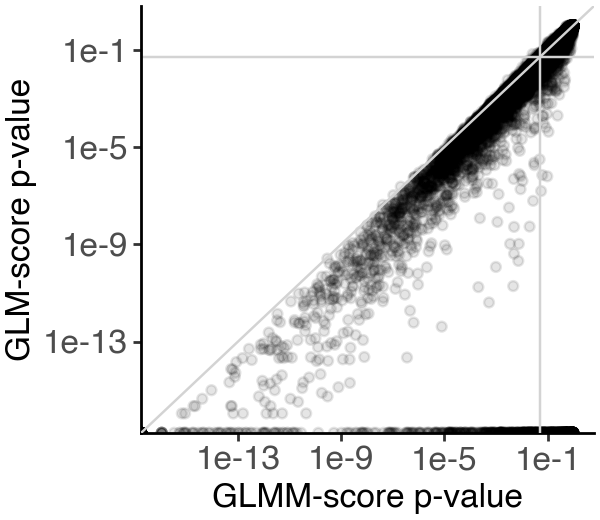

In [64]:
_df = df_du_cbs
(
    ggplot(_df, aes(x = 'pvalue_glmm_2', y = 'pvalue_glm_2')) +
        # stat_density_2d(levels = 5) + 
        geom_point(alpha = 0.1) + 
        geom_hline(yintercept = 0.05, color = 'lightgray') + 
        geom_vline(xintercept = 0.05, color = 'lightgray') + 
        geom_abline(slope = 1, color = 'lightgray') + 
        labs(x = 'GLMM-score p-value', y = 'GLM-score p-value') + 
        scale_x_log10() + 
        scale_y_log10() + 
        theme_classic() + 
        theme(figure_size=[3,2.6],
             text=element_text(size = 12))
)

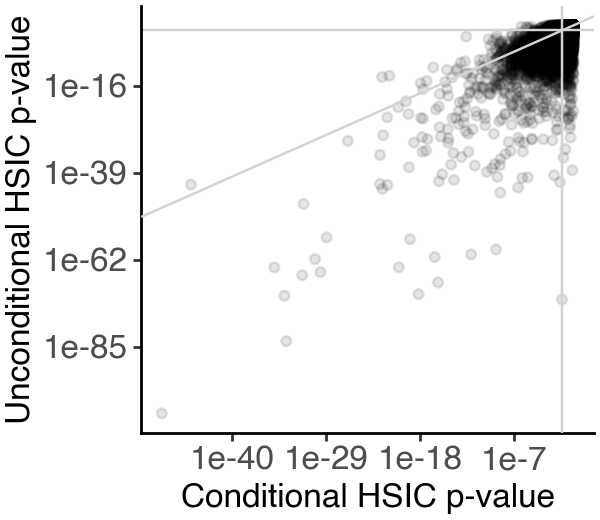

In [65]:
_df = df_du_cbs
(
    ggplot(_df, aes(y = 'pvalue_hsic_2', x = 'pvalue_hsic-gp_2')) +
        # stat_density_2d(levels = 5) + 
        geom_point(alpha = 0.1) + 
        geom_hline(yintercept = 0.05, color = 'lightgray') + 
        geom_vline(xintercept = 0.05, color = 'lightgray') + 
        geom_abline(slope = 1, color = 'lightgray') + 
        labs(y = 'Unconditional HSIC p-value', x = 'Conditional HSIC p-value') + 
        scale_x_log10() + 
        scale_y_log10() + 
        theme_classic() + 
        theme(figure_size=[3,2.6],
             text=element_text(size = 12))
)

### Prioritize RBP-SVS pairs

#### Check overlap with CLIP data

/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10


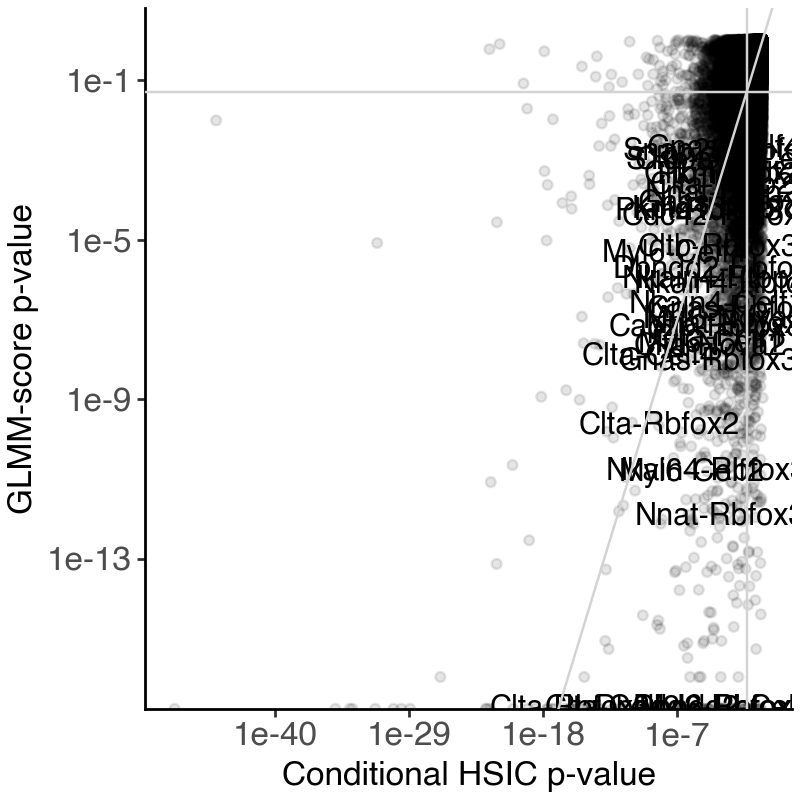

In [67]:
# _df = df_du_cbs.loc[df_du_cbs['is_significant']]
_df = df_du_cbs.copy()
_df['label'] = _df['gene'] + '-' + _df['covariate']

# RBP with CLIP data in POSTAR3-CLIPdb
_rbp_has_clip = pd.read_table(
    '/Users/jysumac/reference/POSTAR3/mouse.rbp_with_clip.txt', header=None
)[0].to_list()
_df['has_clip'] = _df['covariate'].isin(_rbp_has_clip)

(
    ggplot(_df, aes(y = 'pvalue_glmm_2', x = 'pvalue_hsic-gp_2')) +
        geom_point(alpha = 0.1) + 
        geom_text(
            _df.loc[(_df['has_clip']) & (_df['is_significant'])],
            # _df.loc[(_df['pvalue_hsic-gp'] < 0.01) | (_df['pvalue_glmm'] < 0.01)],
            aes(label = 'label')
        ) + 
        geom_hline(yintercept = 0.05, color = 'lightgray') + 
        geom_vline(xintercept = 0.05, color = 'lightgray') + 
        geom_abline(slope = 1, color = 'lightgray') + 
        labs(y = 'GLMM-score p-value', x = 'Conditional HSIC p-value') + 
        scale_x_log10() + 
        scale_y_log10() + 
        theme_classic() + 
        theme(figure_size=[4, 4],
             text=element_text(size = 12))
)

#### RBP with most DU associations

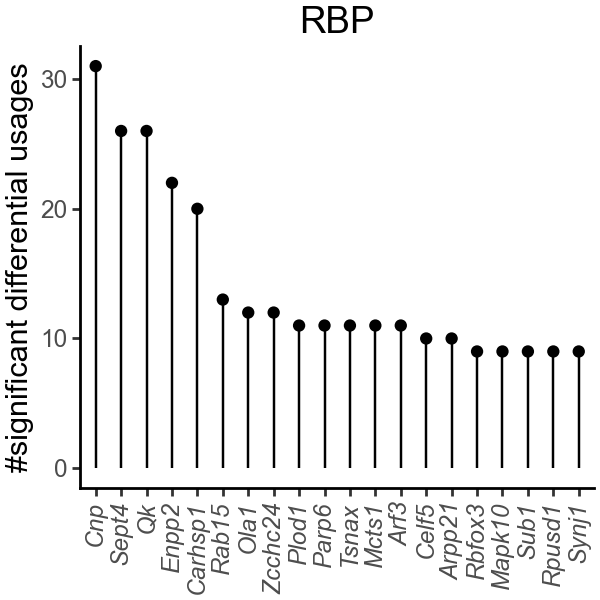

In [68]:
_df = df_du_cbs.reset_index().groupby(['covariate'])['is_significant'].sum().to_frame('counts').sort_values(
    'counts', ascending = False
).reset_index()
_df['covariate'] = pd.Categorical(_df['covariate'], ordered=True, categories=_df['covariate'])

(
    ggplot(_df.head(20), aes(x = 'covariate', y = 'counts')) + 
        geom_point() + 
        geom_segment(aes(x = 'covariate', y = 0, xend = 'covariate', yend = 'counts')) +
        # geom_bar(stat = 'identity') + 
        labs(x = '', y = '#significant differential usages', title = 'RBP') + 
        theme_classic() + 
        theme(
            figure_size=(3, 3),
            text=element_text(family='Arial'),
            axis_text_x=element_text(rotation=90, hjust = 0.5, fontstyle = 'italic')
        )
)

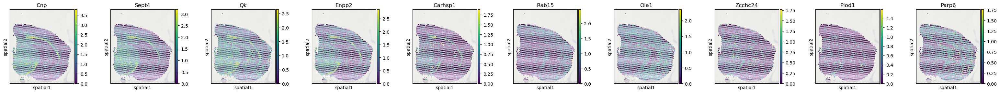

In [69]:
_rbp_to_plot = _df.head(10)['covariate'].to_list()
with plt.rc_context({"figure.figsize": (3, 3)}):
    sc.pl.spatial(adata_visium_rbp, color = _rbp_to_plot, img_key = 'lowres', alpha_img = 0.3, layer = 'log1p', ncols = len(_rbp_to_plot))

In [70]:
_df = df_du_cbs.copy()
_df.reset_index().loc[_df.reset_index()['covariate'] == 'Qk'].sort_values(
    'pvalue_hsic-gp_2', ascending=True
).head(15)

,index,gene,covariate,pvalue_hsic_1,pvalue_hsic-gp_1,pvalue_glm_1,pvalue_glmm_1,is_significant_1,pvalue_hsic_2,pvalue_hsic-gp_2,pvalue_glm_2,pvalue_glmm_2,is_significant_2,is_significant
20145,20145,Clta,Qk,3.311314e-85,3.667357e-43,0.000000e+00,0.000000e+00,True,8.398294e-67,1.635848e-32,0.000000e+00,0.000000e+00,True,True
21110,21110,Cltb,Qk,6.309817e-25,8.185083e-19,3.869843e-10,1.388102e-09,True,5.699536e-23,7.735272e-17,1.820185e-10,1.683405e-09,True,True
62605,62605,Pkm,Qk,1.677521e-12,4.177714e-08,4.077418e-07,7.051646e-07,True,2.329028e-19,2.094253e-15,7.830405e-09,2.520302e-08,True,True
24005,24005,Dbndd2,Qk,2.115886e-48,1.091533e-18,0.000000e+00,0.000000e+00,True,1.540646e-37,4.527522e-15,0.000000e+00,0.000000e+00,True,True
35585,35585,Gnas,Qk,1.325333e-31,2.028611e-19,0.000000e+00,0.000000e+00,True,6.556571e-27,3.632486e-14,0.000000e+00,0.000000e+00,True,True
15320,15320,Capzb,Qk,1.481530e-24,9.886476e-18,8.515411e-14,2.428058e-13,True,2.018189e-26,1.407980e-13,7.438494e-15,5.440093e-14,True,True
18215,18215,Cdc42,Qk,1.498664e-19,2.729704e-09,3.003911e-09,1.057804e-08,True,9.143202e-25,1.588674e-13,9.650836e-12,1.544427e-10,True,True
71290,71290,S100a16,Qk,2.429122e-20,5.181574e-08,3.646019e-09,1.512840e-07,True,2.193201e-29,4.534596e-13,2.305245e-11,6.310020e-10,True,True
39445,39445,Kctd13,Qk,6.563975e-27,2.710919e-16,3.974598e-14,2.359224e-13,True,3.229825e-28,1.597252e-12,2.349232e-13,1.556422e-12,True,True
70325,70325,Rtn4,Qk,5.308990e-08,1.262342e-03,3.818736e-05,4.486382e-05,True,1.569348e-23,3.738206e-12,1.386669e-13,2.181588e-12,True,True


/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10


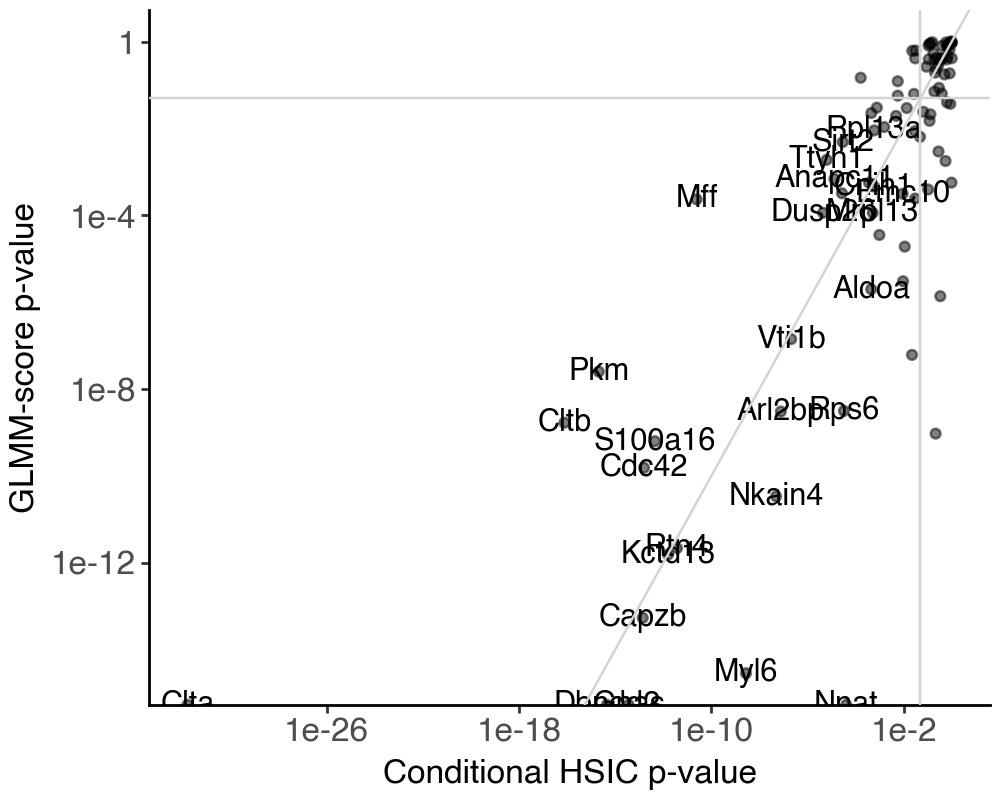

In [71]:
_df = df_du_cbs.reset_index().loc[df_du_cbs.reset_index()['covariate'] == 'Qk', :]
(
    ggplot(_df, aes(y = 'pvalue_glmm_2', x = 'pvalue_hsic-gp_2')) +
        geom_point(alpha = 0.5) + 
        geom_text(
            _df.loc[_df['is_significant']],
            aes(label = 'gene')
        ) + 
        geom_hline(yintercept = 0.05, color = 'lightgray') + 
        geom_vline(xintercept = 0.05, color = 'lightgray') + 
        geom_abline(slope = 1, color = 'lightgray') + 
        labs(y = 'GLMM-score p-value', x = 'Conditional HSIC p-value') + 
        scale_x_log10() + 
        scale_y_log10() + 
        theme_classic() + 
        theme(figure_size=[5,4],
             text=element_text(size = 12))
)

In [72]:
_df = df_du_cbs.copy()
_df.reset_index().loc[_df.reset_index()['covariate'] == 'Rbfox3'].sort_values(
    'pvalue_hsic-gp_2', ascending=True
).head(15)

,index,gene,covariate,pvalue_hsic_1,pvalue_hsic-gp_1,pvalue_glm_1,pvalue_glmm_1,is_significant_1,pvalue_hsic_2,pvalue_hsic-gp_2,pvalue_glm_2,pvalue_glmm_2,is_significant_2,is_significant
19989,19989,Clta,Rbfox3,1.717763e-47,3.434021e-14,0.000000e+00,0.000000e+00,True,6.151540e-42,1.777966e-16,0.000000e+00,0.000000e+00,True,True
62449,62449,Pkm,Rbfox3,3.771058e-06,5.458211e-03,7.097446e-03,8.181817e-03,True,7.607988e-08,5.624028e-06,3.166673e-05,5.104465e-05,True,True
23849,23849,Dbndd2,Rbfox3,1.519721e-24,2.752810e-06,0.000000e+00,0.000000e+00,True,3.123965e-17,9.053482e-06,0.000000e+00,0.000000e+00,True,True
15164,15164,Capzb,Rbfox3,4.412456e-13,3.025874e-08,3.852882e-06,5.024311e-06,True,5.762672e-14,2.285952e-05,2.570323e-08,5.964328e-08,True,True
56659,56659,Nkain4,Rbfox3,9.895055e-12,2.252231e-05,2.795092e-07,5.936460e-07,True,2.072953e-11,2.738181e-05,6.081802e-13,1.567635e-11,True,True
35429,35429,Gnas,Rbfox3,1.456814e-17,2.911804e-07,1.486355e-11,3.042169e-10,True,2.209962e-14,3.417840e-05,1.301959e-12,8.790697e-09,True,True
20954,20954,Cltb,Rbfox3,1.784688e-15,3.389200e-08,3.944002e-06,8.643340e-06,True,1.784881e-09,2.088256e-04,1.293198e-06,6.435623e-06,True,True
45079,45079,Mff,Rbfox3,4.969626e-05,4.383274e-02,2.460730e-01,2.550077e-01,False,2.607576e-08,3.067632e-04,9.221714e-03,1.654478e-02,False,False
57624,57624,Nnat,Rbfox3,3.419748e-14,2.614654e-07,0.000000e+00,4.418133e-12,True,4.176435e-12,3.234659e-04,0.000000e+00,1.160627e-12,True,True
42184,42184,Lmo4,Rbfox3,2.895095e-02,1.445148e-01,3.636654e-01,4.066379e-01,False,3.687974e-02,3.316868e-04,4.337955e-01,4.859153e-01,False,False


/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10


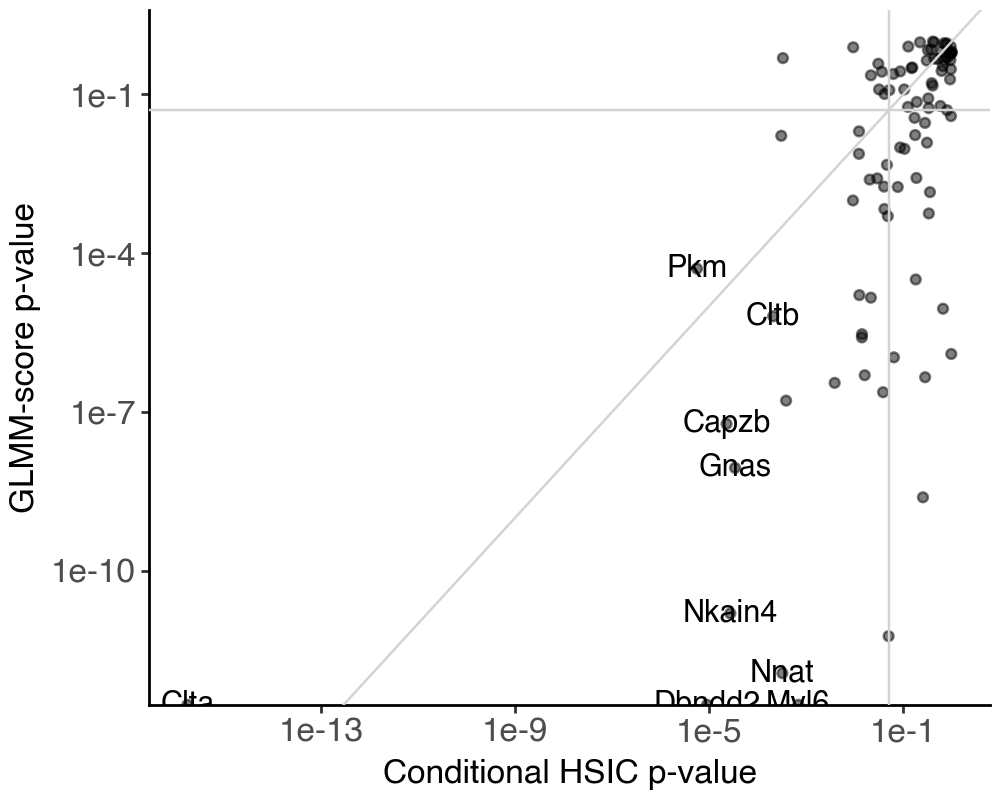

In [73]:
_df = df_du_cbs.reset_index().loc[df_du_cbs.reset_index()['covariate'] == 'Rbfox3', :]
(
    ggplot(_df, aes(y = 'pvalue_glmm_2', x = 'pvalue_hsic-gp_2')) +
        geom_point(alpha = 0.5) + 
        geom_text(
            _df.loc[_df['is_significant']],
            aes(label = 'gene')
        ) + 
        geom_hline(yintercept = 0.05, color = 'lightgray') + 
        geom_vline(xintercept = 0.05, color = 'lightgray') + 
        geom_abline(slope = 1, color = 'lightgray') + 
        labs(y = 'GLMM-score p-value', x = 'Conditional HSIC p-value') + 
        scale_x_log10() + 
        scale_y_log10() + 
        theme_classic() + 
        theme(figure_size=[5,4],
             text=element_text(size = 12))
)

#### SVS genes with most DU associations

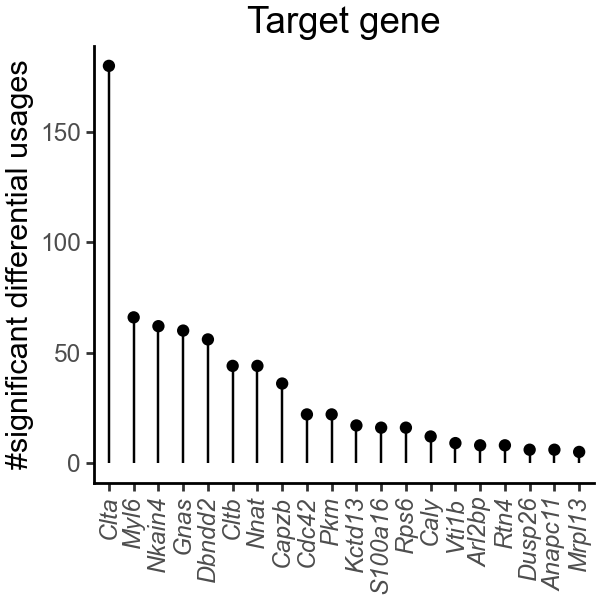

In [74]:
_df = df_du_cbs.reset_index().groupby(['gene'])['is_significant'].sum().to_frame('counts').sort_values(
    'counts', ascending = False
).reset_index()
_df['gene'] = pd.Categorical(_df['gene'], ordered=True, categories=_df['gene'])

(
    ggplot(_df.head(20), aes(x = 'gene', y = 'counts')) + 
        geom_point() + 
        geom_segment(aes(x = 'gene', y = 0, xend = 'gene', yend = 'counts')) +
        # geom_bar(stat = 'identity') + 
        labs(x = '', y = '#significant differential usages', title = 'Target gene') + 
        theme_classic() + 
        theme(
            figure_size=(3, 3),
            text=element_text(family='Arial'),
            axis_text_x=element_text(rotation=90, hjust = 0.5, fontstyle = 'italic')
        )
)

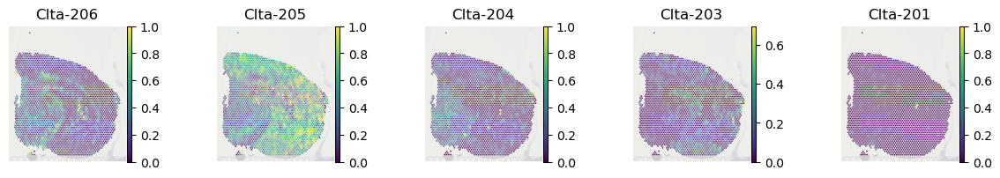

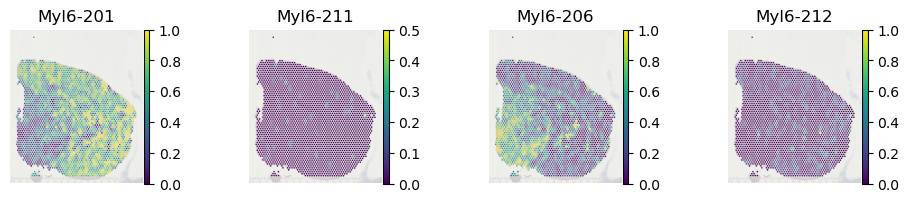

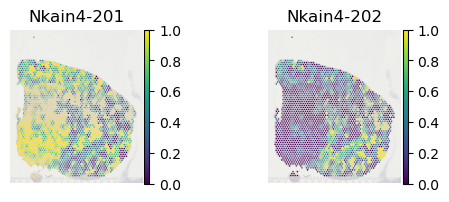

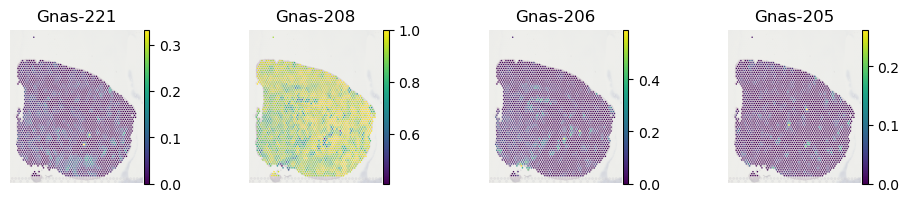

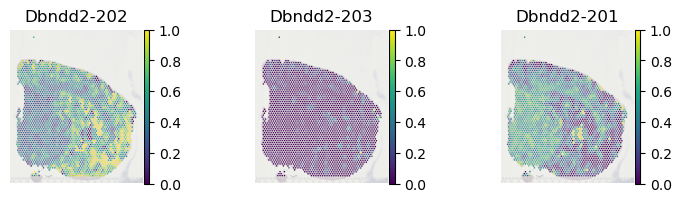

In [75]:
_svs_to_plot = _df.head(5)['gene'].to_list()
with plt.rc_context({"figure.figsize": (2, 2)}):
    for _gene in _svs_to_plot:
        _iso_to_plot = adata_ont_sv.var.index[adata_ont_sv.var['gene_symbol'] == _gene]
        _name_to_plot = adata_ont_sv.var.loc[adata_ont_sv.var['gene_symbol'] == _gene, 'transcript_name']
        sc.pl.spatial(
            adata_ont_sv, color = _iso_to_plot, title = _name_to_plot,
            img_key = 'lowres', alpha_img = 0.3, 
            layer = 'ratios_smoothed', ncols = len(_rbp_to_plot),
            frameon=False
        )

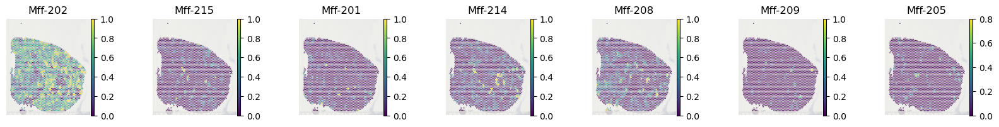

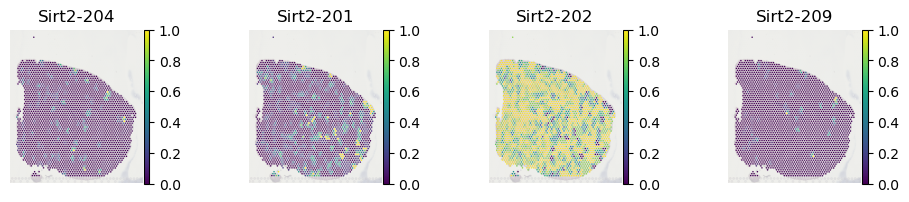

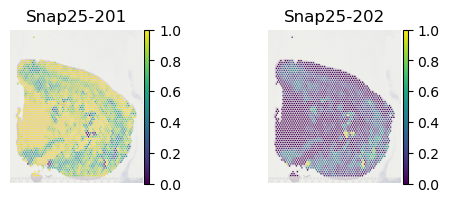

In [76]:
_svs_to_plot = ['Mff', 'Sirt2', 'Snap25']
with plt.rc_context({"figure.figsize": (2, 2)}):
    for _gene in _svs_to_plot:
        _iso_to_plot = adata_ont_sv.var.index[adata_ont_sv.var['gene_symbol'] == _gene]
        _name_to_plot = adata_ont_sv.var.loc[adata_ont_sv.var['gene_symbol'] == _gene, 'transcript_name']
        sc.pl.spatial(
            adata_ont_sv, color = _iso_to_plot, title = _name_to_plot,
            img_key = 'lowres', alpha_img = 0.3, 
            layer = 'ratios_smoothed', ncols = len(_rbp_to_plot),
            frameon=False
        )

#### Plot RBP expression

In [77]:
df_du_cbs.loc[df_du_cbs['covariate'].isin(_rbp_has_clip),:].groupby(['covariate'])['is_significant'].sum().to_frame('counts').sort_values(
    'counts', ascending = False
).reset_index().head(n=10)

,covariate,counts
0,Rbfox3,9
1,Rbfox2,7
2,Celf4,5
3,Celf2,4
4,Rbfox1,3
5,Ptbp2,3
6,Celf1,2
7,Nova2,2
8,Fmr1,1
9,Srrm4,0


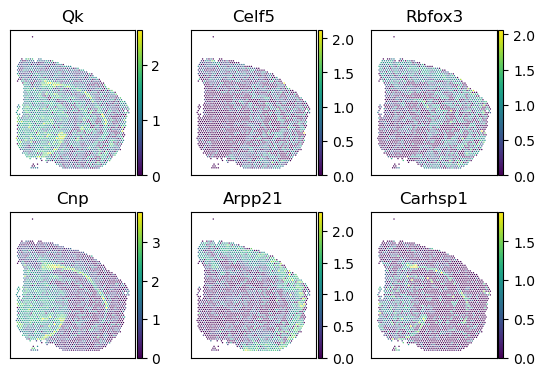

In [78]:
with plt.rc_context({"figure.figsize": (2, 2)}):
    axes = sc.pl.spatial(
        adata_visium_rbp, color = ['Qk', 'Celf5', 'Rbfox3', 'Cnp', 'Arpp21', 'Carhsp1'], 
        ncols = 3, layer = 'log1p',
        title = ['Qk', 'Celf5', 'Rbfox3', 'Cnp', 'Arpp21', 'Carhsp1'], 
        img_key = 'lowres', alpha_img=0.0, wspace=0.1,
        frameon = True, show = False)

    for _ax in axes:
        _ax.set_xlabel('')
        _ax.set_ylabel('')

    plt.show()


#### Coexpression of Rbfox and Celf genes

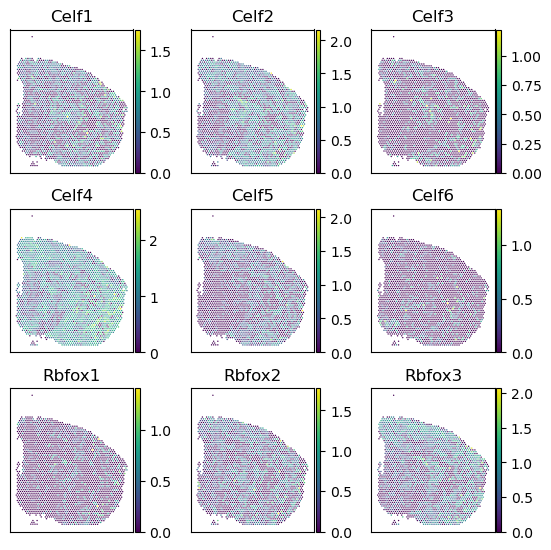

In [79]:
_rbp_to_plots = [f'Celf{i+1}' for i in range(6)] + [f'Rbfox{i+1}' for i in range(3)]
with plt.rc_context({"figure.figsize": (2, 2)}):
    axes = sc.pl.spatial(
        adata_visium_rbp, color = _rbp_to_plots, 
        ncols = 3, layer = 'log1p',
        img_key = 'lowres', alpha_img=0.0, wspace=0.1,
        frameon = True, show = False)

    for _ax in axes:
        _ax.set_xlabel('')
        _ax.set_ylabel('')

    plt.show()

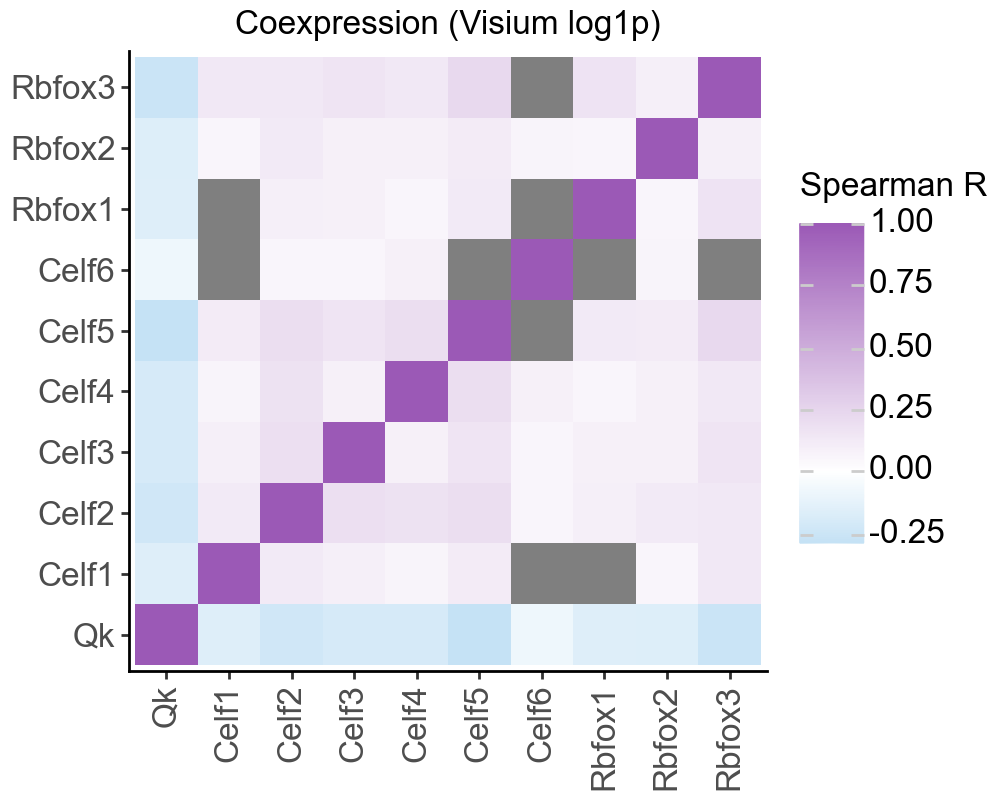

In [80]:
_cols_to_compare = ['Qk'] + [f'Celf{i+1}' for i in range(6)] + [f'Rbfox{i+1}' for i in range(3)]

# calculate Spearmann correlation of RBP expression
_mat = adata_visium_rbp[:, _cols_to_compare].layers['log1p'].toarray()
_conf_mat = pd.DataFrame(
    spearmanr(_mat)[0] * (spearmanr(_mat)[1] <= 0.01),
    columns = _cols_to_compare,
    index = _cols_to_compare
).reset_index(names='id')
_conf_mat = pd.melt(_conf_mat, id_vars='id').round(2)

# remove non-significant results
_conf_mat.loc[_conf_mat['value'] == 0, 'value'] = np.nan

_conf_mat['id'] = pd.Categorical(_conf_mat['id'], ordered=True, categories=_cols_to_compare)
_conf_mat['variable'] = pd.Categorical(_conf_mat['variable'], ordered=True, categories=_cols_to_compare)

(
    ggplot(_conf_mat, aes(x = 'id', y = 'variable', fill = 'value')) + 
        geom_tile() + 
        # geom_text(aes(label = 'value')) + 
        scale_fill_gradient2(low = '#3498DB', high = '#9B59B6', midpoint = 0) + 
        labs(x = '', y = '', fill = 'Spearman R', title = 'Coexpression (Visium log1p)') + 
        theme_classic() + 
        theme(
            figure_size=[5, 4],
            text = element_text(family='Arial', size = 12), 
            axis_text_x=element_text(rotation=90, hjust = 0.5, vjust = 1)
        )
)

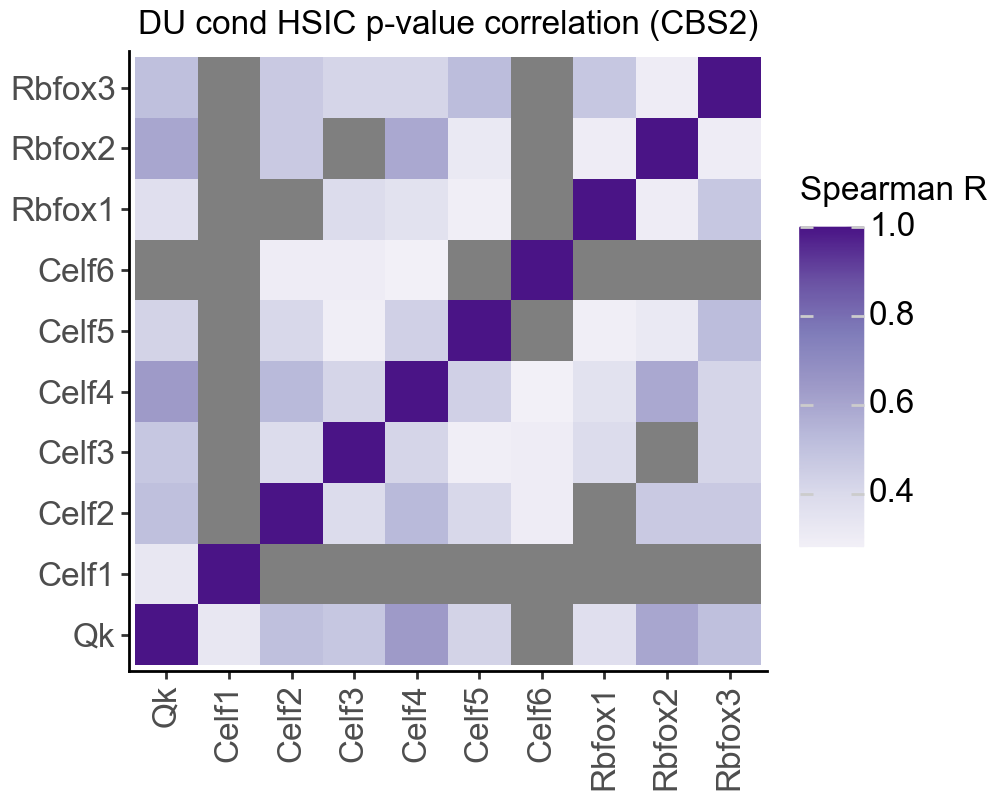

In [81]:
_cols_to_compare = ['Qk'] + [f'Celf{i+1}' for i in range(6)] + [f'Rbfox{i+1}' for i in range(3)]

# calculate Spearmann correlation of RBP DU test p-values
_df = df_du_cbs.loc[df_du_cbs['covariate'].isin(_cols_to_compare)].pivot(
    index=['gene'], columns = 'covariate', values = 'pvalue_hsic-gp_2'
)
_conf_mat = pd.DataFrame(
    spearmanr(_df)[0] * (spearmanr(_df)[1] <= 0.01), 
    columns = _df.columns,
    index = _df.columns
).reset_index(names='id')
_conf_mat = pd.melt(_conf_mat, id_vars='id').round(2)

# remove non-significant results
_conf_mat.loc[_conf_mat['value'] == 0, 'value'] = np.nan

_conf_mat['id'] = pd.Categorical(_conf_mat['id'], ordered=True, categories=_cols_to_compare)
_conf_mat['variable'] = pd.Categorical(_conf_mat['covariate'], ordered=True, categories=_cols_to_compare)

(
    ggplot(_conf_mat, aes(x = 'id', y = 'variable', fill = 'value')) + 
        geom_tile() + 
        # geom_text(aes(label = 'value')) + 
        scale_fill_distiller(palette = 'Purples', direction = 1) + 
        labs(x = '', y = '', fill = 'Spearman R', title = 'DU cond HSIC p-value correlation (CBS2)') + 
        theme_classic() + 
        theme(
            figure_size=[5, 4],
            text = element_text(family='Arial', size = 12), 
            axis_text_x=element_text(rotation=90, hjust = 0.5, vjust = 1)
        )
)

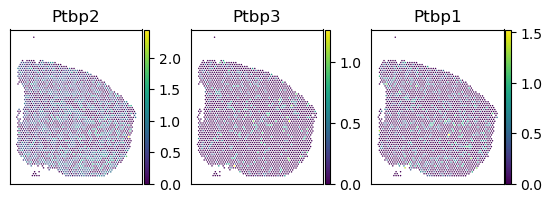

In [82]:
_rbp_to_plots = adata_visium_rbp.var_names[
    adata_visium_rbp.var_names.str.contains('Ptbp')
]
with plt.rc_context({"figure.figsize": (2, 2)}):
    axes = sc.pl.spatial(
        adata_visium_rbp, color = _rbp_to_plots, 
        ncols = 3, layer = 'log1p',
        img_key = 'lowres', alpha_img=0.0, wspace=0.1,
        frameon = True, show = False)

    for _ax in axes:
        _ax.set_xlabel('')
        _ax.set_ylabel('')

    plt.show()

### Visualize representative pairs

#### Clta:Rbfox3

In [103]:
_iso_names = ['Clta-203', 'Clta-204', 'Clta-205', 'Clta-206']
_iso_to_plot = [adata_ont_sv.var_names[adata_ont_sv.var['transcript_name'] == _n].to_list()[0]
                for _n in _iso_names]

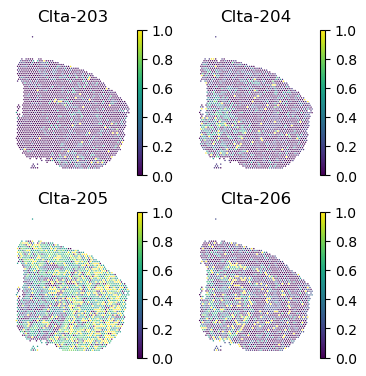

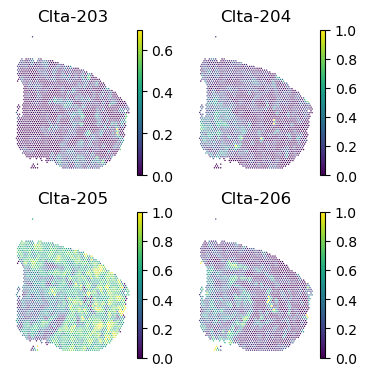

In [104]:
with plt.rc_context({"figure.figsize": (2, 2)}):
    axes = sc.pl.spatial(
        adata_ont_sv, color = _iso_to_plot, title = _iso_names, 
        img_key = 'lowres', alpha_img=0.0,
        layer = 'ratios_obs', ncols = 2, wspace = 0.1,
        frameon = False, show = False
    )

    for _ax in axes:
        _ax.set_xlabel('')
        _ax.set_ylabel('')
        
    plt.show()
    
    axes = sc.pl.spatial(
        adata_ont_sv, color = _iso_to_plot, title = _iso_names, 
        img_key = 'lowres', alpha_img=0.0,
        layer = 'ratios_smoothed', ncols = 2, wspace = 0.1,
        frameon = False, show = False
    )

    for _ax in axes:
        _ax.set_xlabel('')
        _ax.set_ylabel('')
        
    plt.show()

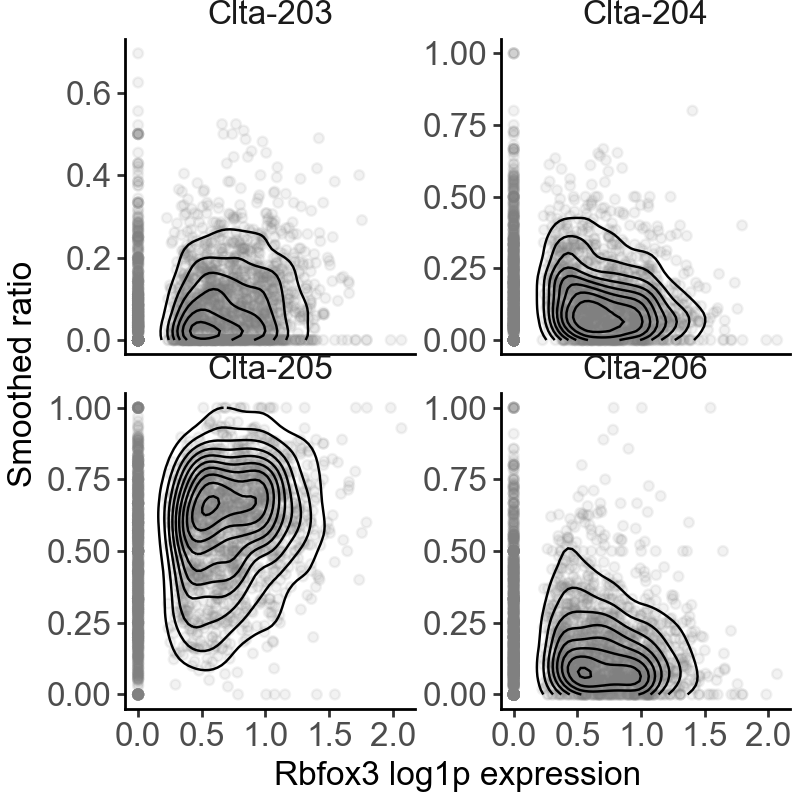

In [105]:
_layer = 'ratios_smoothed'

_df = pd.DataFrame({
    'Rbfox3': adata_visium_rbp[:, 'Rbfox3'].layers['log1p'].toarray().squeeze(),
    'Celf5': adata_visium_rbp[:, 'Celf5'].layers['log1p'].toarray().squeeze(),
    'Qk': adata_visium_rbp[:, 'Qk'].layers['log1p'].toarray().squeeze()
})

for _ind, _name in zip(_iso_to_plot, _iso_names):
    _df[_name] = adata_ont_sv[:, _ind].layers[_layer].squeeze()

df_ratio_n_rbp = _df.melt(id_vars=['Rbfox3', 'Celf5', 'Qk'], var_name='isoform', value_name=_layer)

(
    ggplot(df_ratio_n_rbp, aes(x = 'Rbfox3', y = _layer)) + 
        facet_wrap('~ isoform', scales='free_y', ncol = 2) + 
        geom_point(alpha = 0.1, color = 'gray') + 
        stat_density_2d(
            data=df_ratio_n_rbp.loc[df_ratio_n_rbp['Rbfox3'] > 0],
            levels = 10
        ) + 
        labs(x = 'Rbfox3 log1p expression', y = 'Smoothed ratio') + 
        theme_classic() + 
        theme(
            figure_size=[4, 4],
            text=element_text(family='Arial', size = 12),
            strip_background=element_blank()
        )
)

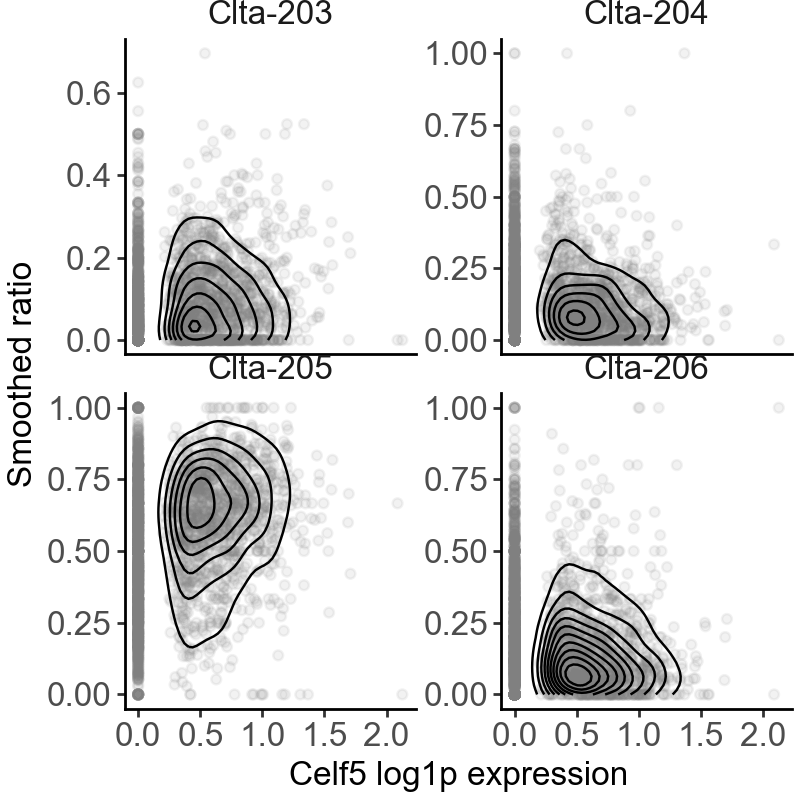

In [106]:
(
    ggplot(df_ratio_n_rbp, aes(x = 'Celf5', y = _layer)) + 
        facet_wrap('~ isoform', scales='free_y', ncol = 2) + 
        geom_point(alpha = 0.1, color = 'gray') + 
        stat_density_2d(
            data=df_ratio_n_rbp.loc[df_ratio_n_rbp['Celf5'] > 0],
            levels = 10
        ) + 
        labs(x = 'Celf5 log1p expression', y = 'Smoothed ratio') + 
        theme_classic() + 
        theme(
            figure_size=[4, 4],
            text=element_text(family='Arial', size = 12),
            strip_background=element_blank()
        )
)

#### Gnas:Rbfox3

In [210]:
_iso_names = ['Gnas-206', 'Gnas-208', 'Gnas-221']
_iso_to_plot = [adata_ont_sv.var_names[adata_ont_sv.var['transcript_name'] == _n].to_list()[0]
                for _n in _iso_names]

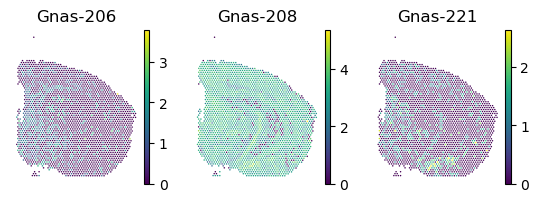

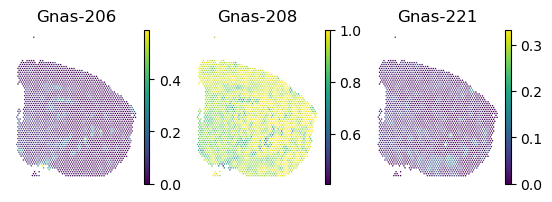

In [211]:
with plt.rc_context({"figure.figsize": (2, 2)}):
    axes = sc.pl.spatial(
        adata_ont_sv, color = _iso_to_plot, title = _iso_names, 
        img_key = 'lowres', alpha_img=0.0,
        layer = 'log1p', ncols = 3, wspace = 0.1,
        frameon = False, show = False
    )

    for _ax in axes:
        _ax.set_xlabel('')
        _ax.set_ylabel('')
        
    plt.show()
    
    axes = sc.pl.spatial(
        adata_ont_sv, color = _iso_to_plot, title = _iso_names, 
        img_key = 'lowres', alpha_img=0.0,
        layer = 'ratios_smoothed', ncols = 3, wspace = 0.1,
        frameon = False, show = False
    )

    for _ax in axes:
        _ax.set_xlabel('')
        _ax.set_ylabel('')
        
    plt.show()

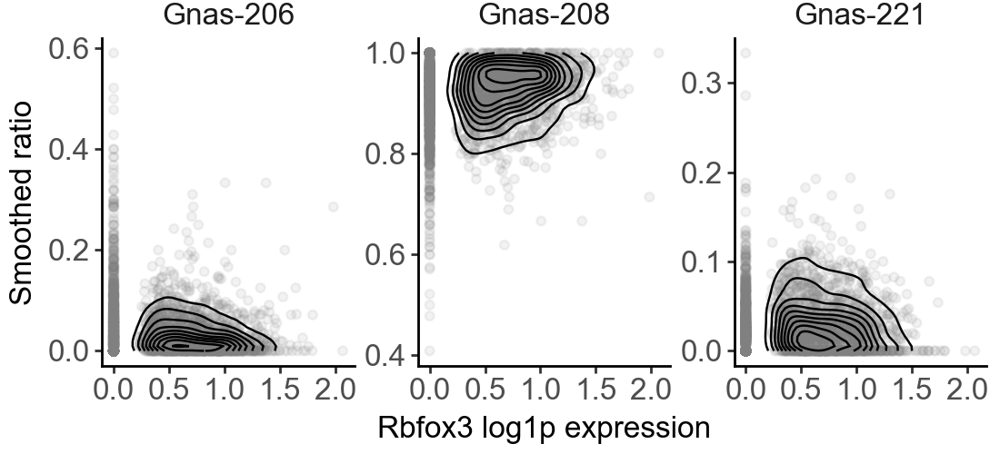

In [109]:
_layer = 'ratios_smoothed'

_df = pd.DataFrame({
    'Rbfox3': adata_visium_rbp[:, 'Rbfox3'].layers['log1p'].toarray().squeeze(),
    'Celf5': adata_visium_rbp[:, 'Celf5'].layers['log1p'].toarray().squeeze(),
    'Qk': adata_visium_rbp[:, 'Qk'].layers['log1p'].toarray().squeeze()
})

for _ind, _name in zip(_iso_to_plot, _iso_names):
    _df[_name] = adata_ont_sv[:, _ind].layers[_layer].squeeze()

df_ratio_n_rbp = _df.melt(id_vars=['Rbfox3', 'Celf5', 'Qk'], var_name='isoform', value_name=_layer)

(
    ggplot(df_ratio_n_rbp, aes(x = 'Rbfox3', y = _layer)) + 
        facet_wrap('~ isoform', scales='free_y', ncol = 3) + 
        geom_point(alpha = 0.1, color = 'gray') + 
        stat_density_2d(
            data=df_ratio_n_rbp.loc[df_ratio_n_rbp['Rbfox3'] > 0],
            levels = 10
        ) + 
        labs(x = 'Rbfox3 log1p expression', y = 'Smoothed ratio') + 
        theme_classic() + 
        theme(
            figure_size=[5.5, 2.5],
            text=element_text(family='Arial', size = 12),
            strip_background=element_blank()
        )
)

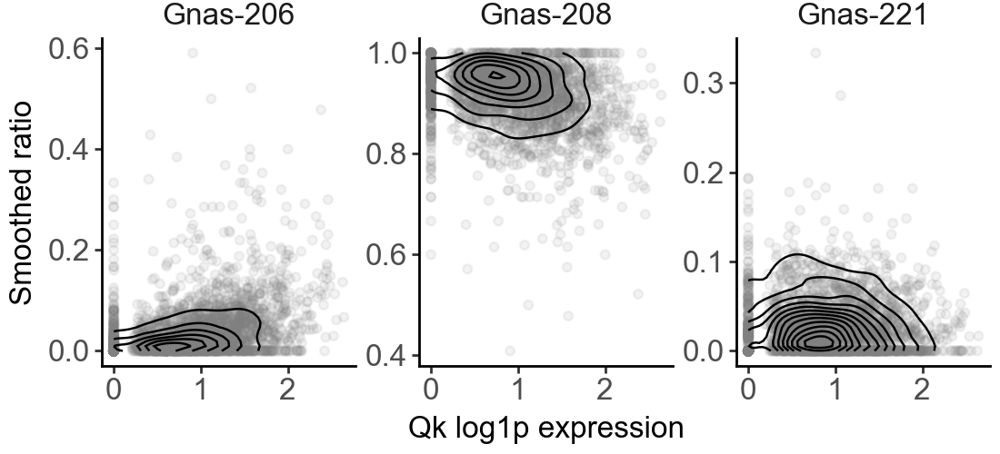

In [110]:
(
    ggplot(df_ratio_n_rbp, aes(x = 'Qk', y = _layer)) + 
        facet_wrap('~ isoform', scales='free_y', ncol = 3) + 
        geom_point(alpha = 0.1, color = 'gray') + 
        stat_density_2d(
            data=df_ratio_n_rbp.loc[df_ratio_n_rbp['Rbfox3'] > 0],
            levels = 10
        ) + 
        labs(x = 'Qk log1p expression', y = 'Smoothed ratio') + 
        theme_classic() + 
        theme(
            figure_size=[5.5, 2.5],
            text=element_text(family='Arial', size = 12),
            strip_background=element_blank()
        )
)

## Save source data of main figures for visualization in R

### SV test results

In [49]:
res_dir = "/Users/jysumac/Projects/SPLISOSM_paper/results/sit_nar_23/"

import os
if not os.path.exists(f"{res_dir}/figures/cbs/source_data/"):
    os.makedirs(f"{res_dir}/figures/cbs/source_data/")

#### Save functional enrichment results

In [50]:
# functional enrichment results
df_go.to_csv(f"{res_dir}/figures/cbs/source_data/go_top20.csv", index = False)
df_kegg.to_csv(f"{res_dir}/figures/cbs/source_data/kegg_top20.csv", index = False)
df_reac.to_csv(f"{res_dir}/figures/cbs/source_data/reac_top20.csv", index = False)

#### Clustering results

In [51]:
# Clustering results
df_clu = adata_ont_sv.obs[['array_row', 'array_col', 'region', 'clu_ont_sve', 'clu_ont_svs', 'clu_visium_rbp_sve']]
df_clu.to_csv(f"{res_dir}/figures/cbs/source_data/clu_res.csv")

### DU test results

In [114]:
res_dir = "/Users/jysumac/Projects/SPLISOSM_paper/results/sit_nar_23/"

df_du_cbs.to_csv(f"{res_dir}/figures/cbs/source_data/du_res_annot.csv", index = False)

#### Save RBP expression

In [5]:
# save RBP expression per spot
_rbp_to_save = [f'Rbfox{i+1}' for i in range(3)] + \
    [f'Celf{i+1}' for i in range(6)] + ['Qk', 'Khdrbs3'] + ['Arpp21'] + \
    ["Ralyl", "Hnrnpk", "Matr3", "Elavl2", "Hnrnph2", "Zfp36l1", "Hnrnpa1", "Adar"]

df_rbp_expr = []
for _layer in ['log1p', 'counts']:
    df_expr = adata_ont_sv.obs[['array_row', 'array_col']].reset_index(names = 'barcode')
    for _rbp in _rbp_to_save:
        df_expr[_rbp] = adata_visium_rbp[df_expr['barcode'], _rbp].layers[_layer].toarray().squeeze()

    df_expr = df_expr.melt(id_vars=['barcode', 'array_row', 'array_col'], 
                           var_name='gene', value_name='expression')
    df_expr['layer'] = _layer
    df_rbp_expr.append(df_expr)

df_rbp_expr = pd.concat(df_rbp_expr, axis = 0)
df_rbp_expr.to_csv(f"{res_dir}/figures/cbs/source_data/rbp_expr.csv", index = False)

#### Save isoform usage

In [212]:
# save isoform usage per spot
_svs_to_save = ['Clta', 'Myl6', 'Gnas', 'Nkain4', 'Dbndd2', 
                'Cltb', 'Pkm', 'Capzb', 'Cdc42', 'S100a16', 
                'Nnat', 'Kctd13', 'Cnih1']

df_svs_ratio = []
for _layer in ['log1p', 'ratios_obs', 'ratios_smoothed']:
    df_layer = []
    # loop over SVS genes
    for _svs in _svs_to_save:
        df_svs = adata_ont_sv.obs[['array_row', 'array_col']].reset_index(names = 'barcode')
        _iso_list = adata_ont_sv.var_names[adata_ont_sv.var['gene_symbol'] == _svs]
        for _iso in _iso_list:
            df_svs[_iso] = adata_ont_sv[df_svs['barcode'], _iso].layers[_layer].toarray().squeeze()
        df_svs = df_svs.melt(id_vars=['barcode', 'array_row', 'array_col'], 
                             var_name='isoform', value_name='ratio')
        df_svs = pd.merge(
            df_svs, adata_ont_sv.var[['transcript_id', 'transcript_name']],
            how = 'left', left_on=['isoform'], right_index=True
        )
        df_svs['gene'] = _svs
        df_layer.append(df_svs)

    # concatenate all genes
    df_layer = pd.concat(df_layer, axis = 0)
    df_layer['layer'] = _layer
    df_svs_ratio.append(df_layer)

df_svs_ratio = pd.concat(df_svs_ratio, axis = 0)
df_svs_ratio.to_csv(f"{res_dir}/figures/cbs/source_data/svs_ratio.csv", index = False)

### Sequence feature analysis

#### Save transcript IDs for SV genes

In [117]:
res_dir = "/Users/jysumac/Projects/SPLISOSM_paper/results/sit_nar_23/"

import os
if not os.path.exists(f"{res_dir}/transcripts/cbs"):
    os.makedirs(f"{res_dir}/transcripts/cbs")

# _df = df_sv_cbs.loc[df_sv_cbs['is_ont_expressed']].copy()
_df = df_sv_cbs.copy()

In [118]:
adata_ont = sc.read_h5ad(f"{res_dir}/anndata/cbs2_ont_filtered_{date}.h5ad")

# SVS genes only
iso_svs = adata_ont.var.loc[
    adata_ont.var['gene_symbol'].isin(_df.index[_df['is_ont_svs']]), 
    ['features', 'gene_symbol', 'transcript_id', 'transcript_name']
].sort_values('gene_symbol')
iso_svs.to_csv(f"{res_dir}/transcripts/cbs/cbs_svs.txid.csv", header = True, index = False)

print(f"Saving IDs for {iso_svs['transcript_id'].nunique()} isoforms of {iso_svs['gene_symbol'].nunique()} SVS genes.")

Saving IDs for 465 isoforms of 150 SVS genes.


In [119]:
# SVE but not SVS genes only
iso_svens = adata_ont.var.loc[
    adata_ont.var['gene_symbol'].isin(_df.index[(~ _df['is_ont_svs']) & _df['is_ont_sve']]), 
    ['features', 'gene_symbol', 'transcript_id', 'transcript_name']
].sort_values('gene_symbol')
iso_svens.to_csv(f"{res_dir}/transcripts/cbs/cbs_svens.txid.csv", header = True, index = False)

print(f"Saving IDs for {iso_svens['transcript_id'].nunique()} isoforms of {iso_svens['gene_symbol'].nunique()} SVE\\SVS genes.")

Saving IDs for 4866 isoforms of 1893 SVE\SVS genes.


#### Load SUPPA parsed events

In [164]:
res_dir = "/Users/jysumac/Projects/SPLISOSM_paper/results/sit_nar_23/"

df_events_svs = pd.read_table(
    f"{res_dir}/transcripts/cbs/suppa.out/cbs_svs/n_events.txt", names=['type', 'count'], sep = ' '
)
df_events_svens = pd.read_table(
    f"{res_dir}/transcripts/cbs/suppa.out/cbs_svens/n_events.txt", names=['type', 'count'], sep = ' '
)

# test for differences in AS type
# _, _pval = chisquare(
#     df_events_svs['count'], 
#     df_events_svens['count'] / df_events_svens['count'].sum() * df_events_svs['count'].sum()
# )
_, _pval, _, _ = chi2_contingency([df_events_svs['count'], df_events_svens['count']])
_pval

5.351538674431136e-12

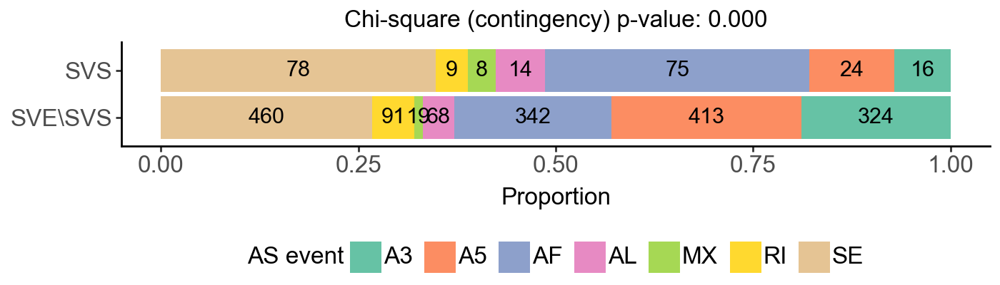

In [165]:
df_events = pd.concat([
    df_events_svs.assign(group = 'SVS'),
    df_events_svens.assign(group = 'SVE\\SVS'),
])
df_events['proportion'] = df_events.groupby('group')['count'].transform(lambda x: x / x.sum())

(
    ggplot(df_events, aes(x = 'group', y = 'count', fill = 'type')) + 
        geom_bar(position="fill", stat="identity") + 
        geom_text(aes(label = 'count', y = 'proportion'), position = position_stack(vjust = .5)) + 
        labs(y = 'Proportion', x = '', fill = 'AS event', title = f'Chi-square (contingency) p-value: {_pval:.3f}') +
        scale_fill_brewer(type = 'qual', palette = 7) + 
        coord_flip() + 
        theme_classic() + 
        theme(
            figure_size=(7,2), 
            legend_position='bottom',
            text = element_text(size = 12, family='arial'),
        ) + 
        guides(fill = guide_legend(nrow = 1))
)